In [44]:
import ma_codes as codes
from ma_codes import mysize, mymap, gray_red

import warnings
warnings.filterwarnings("ignore")

import numpy as np
import matplotlib.pyplot as plt
import scanpy as sc
import pandas as pd
import seaborn as sb

## Some Plotting Parameters
plt.rcParams["figure.figsize"] = (6, 5)
plt.rcParams.update({'font.size': 14})
plt.rcParams['pdf.fonttype'] = 42
sb.set_style("ticks")

pd.set_option("display.max_columns", 100)
import diffxpy.api as de
print(de.__version__)
sc.logging.print_version_and_date()

v0.7.4
Running Scanpy 1.10.2, on 2024-09-04 20:04.


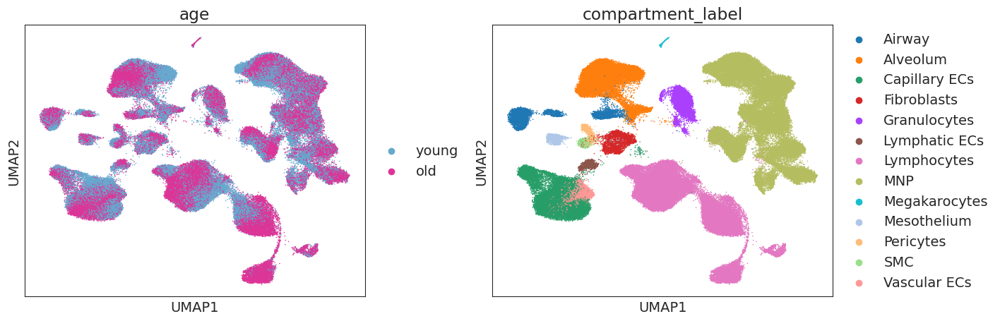

In [45]:
object_folder = "/media/HDD_1/Janine/Aging_SingleCell/data_objects/"
adata = sc.read(object_folder + "230111_Bleo_Ageing_annotated_final.h5ad", cache = False)
sc.pl.umap(adata, color = ["age", "compartment_label"], size = 5, wspace = 0.25)

In [46]:
fibs = adata[adata.obs.compartment_label == "Fibroblasts"].copy()

In [47]:
alv = adata[adata.obs.compartment_label == "Alveolum"].copy()

In [48]:
fibs.obs.cell_type.unique()

['Adventitial fibroblasts', 'Lipofibroblasts', 'Adh7+ fibroblasts', 'Lgr5+ Lgr6+ fibroblasts', 'Lgr5- Lgr6+ fibroblasts', 'Cthrc1+ myofibroblasts', 'Transition', 'Spp1+ myofibroblasts']
Categories (8, object): ['Adventitial fibroblasts', 'Lipofibroblasts', 'Transition', 'Spp1+ myofibroblasts', 'Cthrc1+ myofibroblasts', 'Adh7+ fibroblasts', 'Lgr5+ Lgr6+ fibroblasts', 'Lgr5- Lgr6+ fibroblasts']

In [49]:
alv.obs.cell_type.unique()

['AT2', 'AT2 activated', 'Krt8-ADI', 'AT1']
Categories (4, object): ['AT2', 'AT2 activated', 'Krt8-ADI', 'AT1']

In [50]:
pd.set_option("display.max_columns", 100)
pd.crosstab(fibs.obs.cell_type, fibs.obs.day)

day,d0,d3,d10,d20,d30,d37
cell_type,,,,,,
Adventitial fibroblasts,247,75,87,52,41,44
Lipofibroblasts,318,94,31,34,53,59
Transition,2,46,76,144,34,2
Spp1+ myofibroblasts,0,0,90,182,56,26
Cthrc1+ myofibroblasts,9,13,206,414,115,64
Adh7+ fibroblasts,56,38,18,10,12,6
Lgr5+ Lgr6+ fibroblasts,79,42,22,16,24,21
Lgr5- Lgr6+ fibroblasts,30,21,15,7,12,3


In [51]:
pd.set_option("display.max_columns", 100)
pd.crosstab(alv.obs.cell_type, alv.obs.day)

day,d0,d3,d10,d20,d30,d37
cell_type,,,,,,
AT2,10843,411,152,125,317,1269
AT2 activated,480,2237,605,546,667,218
Krt8-ADI,95,296,411,262,115,110
AT1,132,92,82,135,72,74


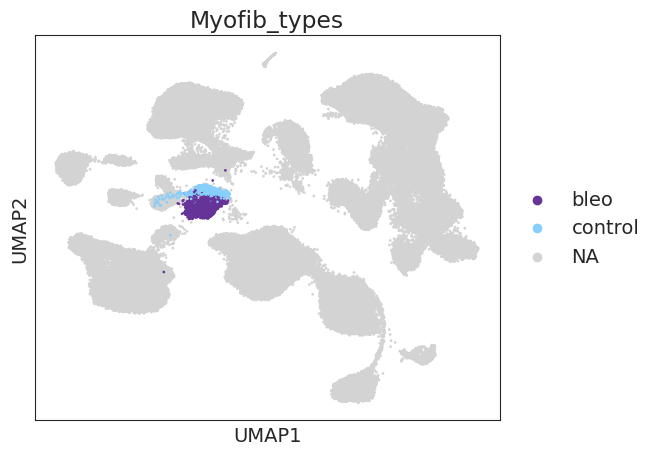

In [52]:
### Since no Myofibroblasts in control condition, we compare to all other fibroblast subtypes

fibro_types = ['Adventitial fibroblasts', 'Lipofibroblasts', "Transition","Cthrc1+ myofibroblasts", "Adh7+ fibroblasts",
              "Lgr5+ Lgr6+ fibroblasts", "Lgr5- Lgr6+ fibroblasts"]

adata.obs["Myofib_types"] = ["control" if (ct in fibro_types) & (treat == "control")
                          else "bleo" if (ct in ["Spp1+ myofibroblasts", "Transition", "Cthrc1+ myofibroblasts"]) 
                             & (treat == "bleo")
                          else "None" for ct, treat in zip(adata.obs.cell_type, adata.obs.treatment)]

sc._utils.sanitize_anndata(adata)
adata.obs.Myofib_types = adata.obs.Myofib_types.cat.reorder_categories(["control", "bleo", "None"])
adata.uns["Myofib_types_colors"] = ["lightskyblue", "rebeccapurple", "lightgray"]
sc.pl.umap(adata, color = ["Myofib_types"], groups = ["control", "bleo"], size = 15, wspace = 0.25)

In [53]:
pd.crosstab(adata.obs.Myofib_types, adata.obs.cell_type).loc[:, fibro_types + ["Spp1+ myofibroblasts"]]

cell_type,Adventitial fibroblasts,Lipofibroblasts,Transition,Cthrc1+ myofibroblasts,Adh7+ fibroblasts,Lgr5+ Lgr6+ fibroblasts,Lgr5- Lgr6+ fibroblasts,Spp1+ myofibroblasts
Myofib_types,,,,,,,,
control,247,318,2,9,56,79,30,0
bleo,0,0,302,812,0,0,0,354
None,299,271,0,0,84,125,58,0


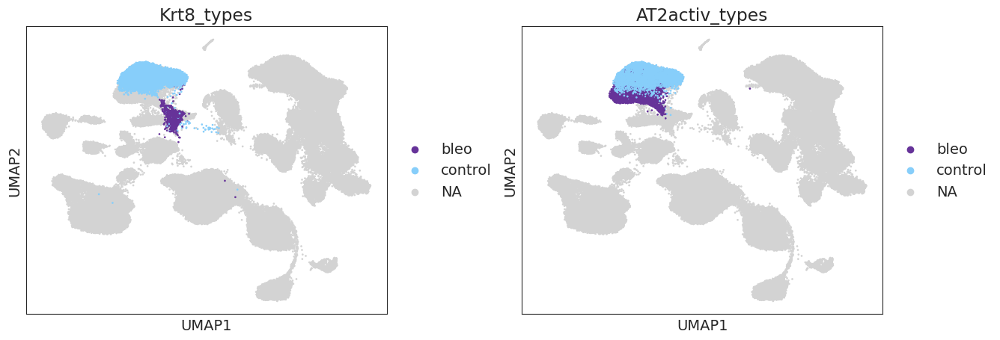

In [54]:
ADI_types = ['AT2', 'Krt8-ADI']
Act_types = ["AT2", "AT2 activated"]

adata.obs["Krt8_types"] = ["control" if (ct in ADI_types) & (treat == "control")
                           else "bleo" if (ct == "Krt8-ADI") & (treat == "bleo")
                           else "None" for ct, treat in zip(adata.obs.cell_type, adata.obs.treatment)]

adata.obs["AT2activ_types"] = ["control" if (ct in Act_types) & (treat == "control")
                               else "bleo" if (ct == "AT2 activated") & (treat == "bleo")
                               else "None" for ct, treat in zip(adata.obs.cell_type, adata.obs.treatment)]

sc._utils.sanitize_anndata(adata)
adata.obs.Krt8_types = adata.obs.Krt8_types.cat.reorder_categories(["control", "bleo", "None"])
adata.uns["Krt8_types_colors"] = ["lightskyblue", "rebeccapurple", "lightgray"]
adata.obs.AT2activ_types = adata.obs.AT2activ_types.cat.reorder_categories(["control", "bleo", "None"])
adata.uns["AT2activ_types_colors"] = ["lightskyblue", "rebeccapurple", "lightgray"]
sc.pl.umap(adata, color = ["Krt8_types", "AT2activ_types"], groups = ["control", "bleo"], size = 15, wspace = 0.25)

In [55]:
lym = adata[adata.obs.compartment_label == "Lymphocytes"].copy()

In [ ]:
GzmkT_types = ['AT2', 'Krt8-ADI']
adata.obs["AT2activ_types"] = ["control" if (ct in Act_types) & (treat == "control")
                               else "bleo" if (ct == "AT2 activated") & (treat == "bleo")
                               else "None" for ct, treat in zip(adata.obs.cell_type, adata.obs.treatment)]

sc._utils.sanitize_anndata(adata)
adata.obs.Krt8_types = adata.obs.Krt8_types.cat.reorder_categories(["control", "bleo", "None"])
adata.uns["Krt8_types_colors"] = ["lightskyblue", "rebeccapurple", "lightgray"]
adata.obs.AT2activ_types = adata.obs.AT2activ_types.cat.reorder_categories(["control", "bleo", "None"])
adata.uns["AT2activ_types_colors"] = ["lightskyblue", "rebeccapurple", "lightgray"]
sc.pl.umap(adata, color = ["Krt8_types", "AT2activ_types"], groups = ["control", "bleo"], size = 15, wspace = 0.25)

In [12]:
adata.obs.Myofib_types.value_counts()

Myofib_types
None       158268
bleo         1468
control       741
Name: count, dtype: int64

In [13]:
pd.crosstab(adata.obs.Krt8_types, adata.obs.cell_type).loc[:, ["AT2", "AT2 activated", "Krt8-ADI"]]

cell_type,AT2,AT2 activated,Krt8-ADI
Krt8_types,,,
control,10843,0,95
bleo,0,0,1194
None,2274,4753,0


In [14]:
pd.crosstab(adata.obs.AT2activ_types, adata.obs.cell_type).loc[:, ["AT2", "AT2 activated", "Krt8-ADI"]]

cell_type,AT2,AT2 activated,Krt8-ADI
AT2activ_types,,,
control,10843,480,0
bleo,0,4273,0
None,2274,0,1289


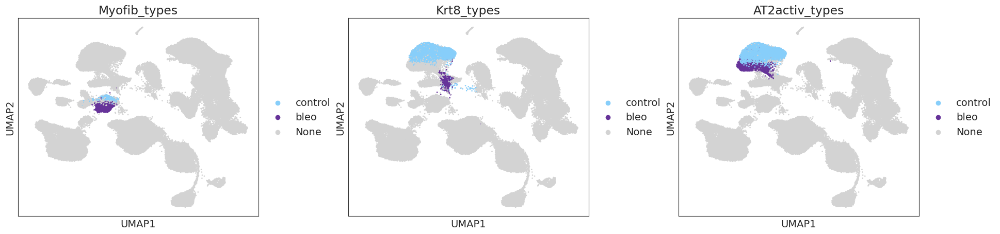

In [15]:
sc.pl.umap(adata, color = ["Myofib_types", "Krt8_types", "AT2activ_types"], size = 15, wspace = 0.25)

### Run Parameter and Function

In [16]:
def dge(a, ct = "Airway", ct_label = "meta_label", condition = "treatment", ref = "control", 
        pct_thresh = 0.05, subset = ["control", "bleo"], min_cells = 10, do_return = None, 
        suffix = "", myofib = None):
    
    if myofib:
        cells = a.obs.loc[:, ct_label].isin(subset)
    else:
        cells = a.obs.loc[:, ct_label] == ct
    
    count = a[cells].obs.loc[:, condition].value_counts()
    if (len(count) < 2) or (count[0] < min_cells) or (count[1] < min_cells):
        print("Too few cells in one condition (%s)\n%s" %(ct, count))
        return
        
    ## As threshold, take 5% of all cells in cell type per group
    tab = pd.DataFrame(index = a.var_names)
    tab = codes.add_pct(a[cells], tab = tab, group_by = condition,
                        gene_label = "index", ids = subset)
    test_genes = tab[(tab.loc[:, "pct.%s" %subset[0]] > pct_thresh) | (tab.loc[:, "pct.%s" %subset[1]] > pct_thresh)].index

    if myofib:
        print("Running Myofibroblast Version")
        adata_raw = codes.generate_count_object(a[:, test_genes], condition = condition,
                                                cell_type_label = ct_label, cell_type = subset, 
                                                ref = ref, min_cells = 5, subset = subset)
    
    else:
        adata_raw = codes.generate_count_object(a[:, test_genes], condition = condition, 
                                                cell_type_label = ct_label, cell_type = [ct], 
                                                ref = ref, min_cells = 5, subset = subset)

    print("Started Diffxpy Calculation:\t%s" %codes.timestamp())

    de_test = de.test.wald(data = adata_raw.X, formula_loc = "~ 1 + %s" %condition,
                           factor_loc_totest = condition,
                           training_strategy = [{"max_steps": 100, "update_b_freq": 5,
                                                "ftol_b": 1e-8, "max_iter_b": 100}],
                           gene_names = adata_raw.var_names, sample_description = adata_raw.obs,
                           noise_model = "nb", size_factors = "n_counts_scaled")

    print("Finished Diffxpy Calculation:\t%s" %codes.timestamp())

    ## Export Table
    res = codes.tidy_table(de_test, a, cells = adata_raw.obs_names, ids = subset,
                           group_by = condition, qval_thresh = 1.0)


    filename = "diffxpy_%s_vs_%s_%s_%s%s.txt" %(subset[0], subset[1], ct.replace(" ", "_"), time.replace(" ", ""), suffix)
    print("Saving to %s\n" %filename)
    res.to_csv("%s%s" %(out_folder, filename), sep = "\t", index = False)
    
    if do_return:
        return res
    

### Young Mice

In [17]:
out_folder = "/media/HDD_1/Janine/Aging_SingleCell/data/DGE_data/dge_targeted_young/"

In [18]:
adata.obs["n_counts_scaled"] = adata.obs["n_counts"] / adata.obs["n_counts"].mean()

#### activated AT2

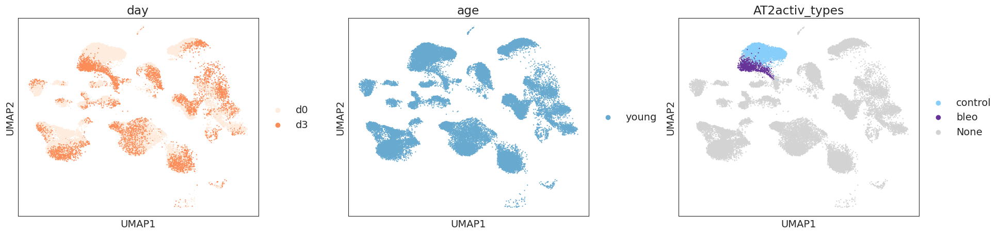

AT2_activated - d3
Running Myofibroblast Version
(8655, 5154)


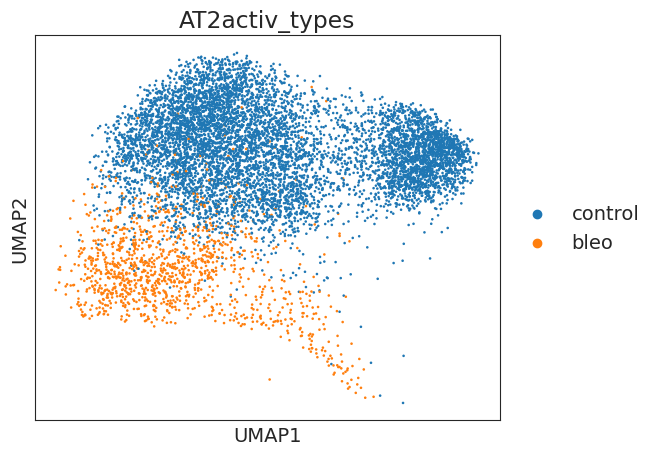

Started Diffxpy Calculation:	04-09-2024 15:44:37
training location model: True
training scale model: True
iter   0: ll=19026934.408743
iter   1: ll=17285468.023227, converged: 0.00% (loc: 0.50%, scale update: False), in 2.82sec
iter   2: ll=16883575.924702, converged: 0.00% (loc: 0.50%, scale update: False), in 2.89sec
iter   3: ll=16855204.919434, converged: 0.00% (loc: 0.50%, scale update: False), in 2.98sec
iter   4: ll=16854694.820697, converged: 0.00% (loc: 0.50%, scale update: False), in 3.02sec
iter   5: ll=16854688.385311, converged: 0.00% (loc: 0.60%, scale update: False), in 2.74sec
iter   6: ll=15425695.588071, converged: 0.00% (loc: 0.00%, scale update: True), in 39.34sec
iter   7: ll=15421862.077913, converged: 0.00% (loc: 0.00%, scale update: False), in 2.76sec
iter   8: ll=15421589.401098, converged: 0.00% (loc: 0.27%, scale update: False), in 2.79sec
iter   9: ll=15421572.820908, converged: 0.00% (loc: 1.86%, scale update: False), in 2.80sec
iter  10: ll=15421572.582564

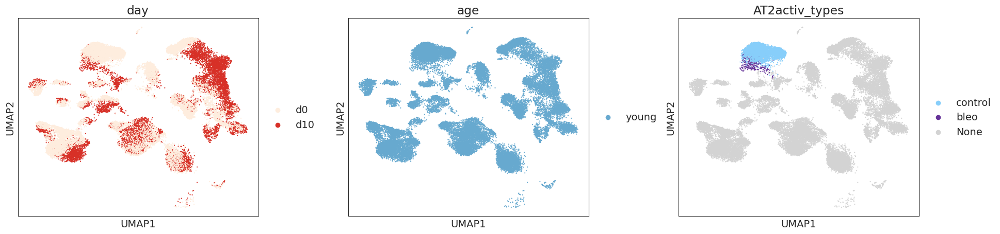

AT2_activated - d10
Running Myofibroblast Version
(7655, 4180)


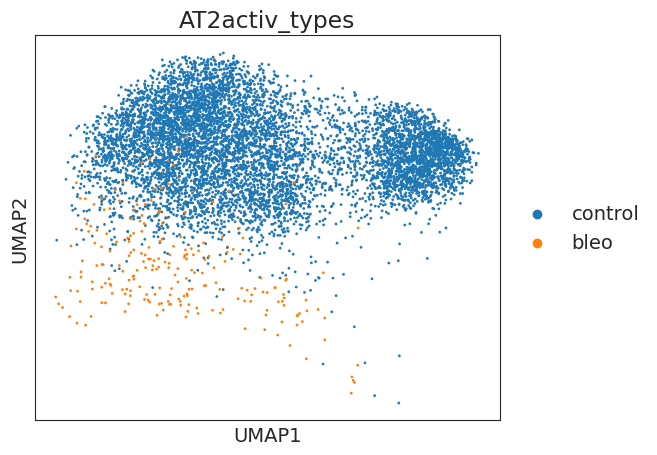

Started Diffxpy Calculation:	04-09-2024 15:48:40
training location model: True
training scale model: True
iter   0: ll=13330768.243491
iter   1: ll=12061761.177940, converged: 0.00% (loc: 0.24%, scale update: False), in 2.17sec
iter   2: ll=11784358.407766, converged: 0.00% (loc: 0.24%, scale update: False), in 2.20sec
iter   3: ll=11768360.367969, converged: 0.00% (loc: 0.24%, scale update: False), in 2.14sec
iter   4: ll=11768174.349581, converged: 0.00% (loc: 0.24%, scale update: False), in 2.38sec
iter   5: ll=11768169.904214, converged: 0.00% (loc: 1.89%, scale update: False), in 2.21sec
iter   6: ll=11327063.569771, converged: 0.00% (loc: 0.00%, scale update: True), in 28.54sec
iter   7: ll=11325446.322141, converged: 0.00% (loc: 0.02%, scale update: False), in 2.13sec
iter   8: ll=11325365.193918, converged: 0.00% (loc: 0.48%, scale update: False), in 2.38sec
iter   9: ll=11325360.281099, converged: 0.00% (loc: 2.75%, scale update: False), in 2.09sec
iter  10: ll=11325359.978549

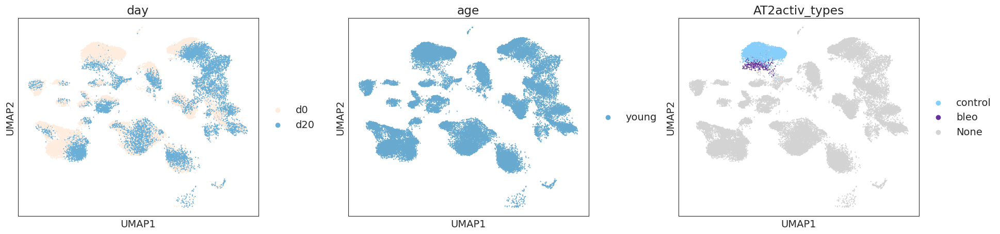

AT2_activated - d20
Running Myofibroblast Version
(7682, 4605)


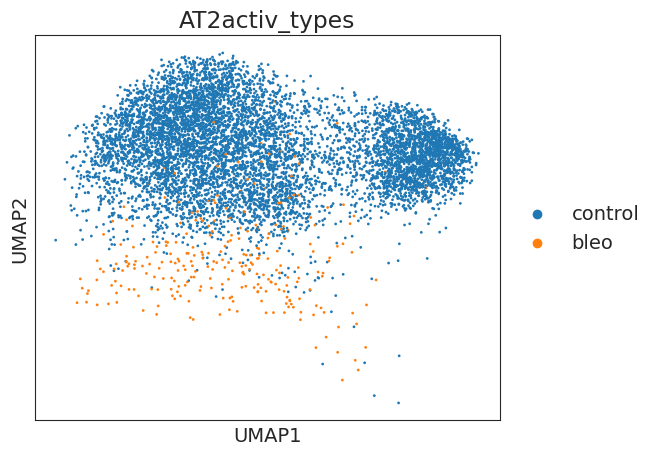

Started Diffxpy Calculation:	04-09-2024 15:51:29
training location model: True
training scale model: True
iter   0: ll=13992549.764248
iter   1: ll=12671577.461130, converged: 0.00% (loc: 0.28%, scale update: False), in 2.34sec
iter   2: ll=12383967.773223, converged: 0.00% (loc: 0.28%, scale update: False), in 2.64sec
iter   3: ll=12367687.741335, converged: 0.00% (loc: 0.28%, scale update: False), in 2.33sec
iter   4: ll=12367543.487846, converged: 0.00% (loc: 0.28%, scale update: False), in 2.61sec
iter   5: ll=12367541.936990, converged: 0.00% (loc: 1.59%, scale update: False), in 2.43sec
iter   6: ll=11880255.344853, converged: 0.00% (loc: 0.00%, scale update: True), in 31.57sec
iter   7: ll=11878707.505423, converged: 0.00% (loc: 0.00%, scale update: False), in 2.39sec
iter   8: ll=11878645.748176, converged: 0.00% (loc: 0.52%, scale update: False), in 2.34sec
iter   9: ll=11878643.090065, converged: 0.00% (loc: 3.87%, scale update: False), in 2.39sec
iter  10: ll=11878643.013683

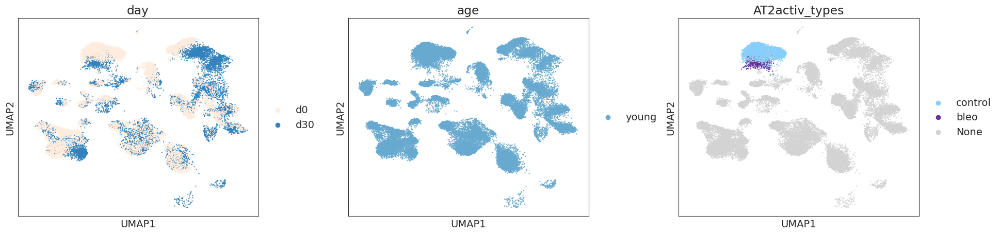

AT2_activated - d30
Running Myofibroblast Version
(7883, 5168)


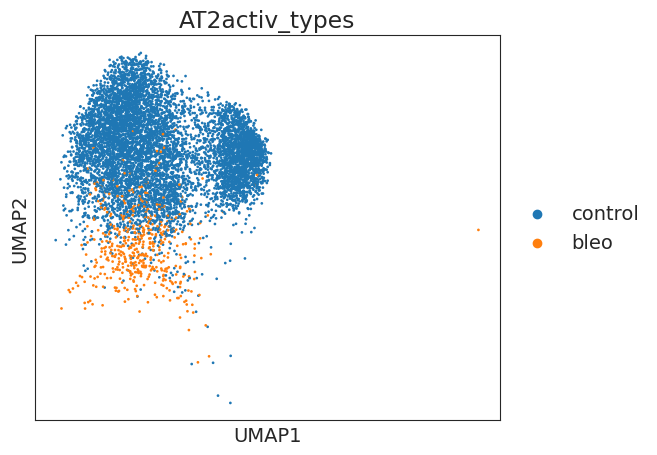

Started Diffxpy Calculation:	04-09-2024 15:54:30
training location model: True
training scale model: True
iter   0: ll=15763965.516596
iter   1: ll=14293565.849163, converged: 0.00% (loc: 0.29%, scale update: False), in 2.73sec
iter   2: ll=13953554.260215, converged: 0.00% (loc: 0.29%, scale update: False), in 2.65sec
iter   3: ll=13927612.347836, converged: 0.00% (loc: 0.29%, scale update: False), in 2.85sec
iter   4: ll=13926660.971681, converged: 0.00% (loc: 0.29%, scale update: False), in 2.77sec
iter   5: ll=13926619.233218, converged: 0.00% (loc: 0.29%, scale update: False), in 2.74sec
iter   6: ll=13284709.607734, converged: 0.00% (loc: 0.00%, scale update: True), in 35.44sec
iter   7: ll=13280881.542735, converged: 0.00% (loc: 0.02%, scale update: False), in 2.68sec
iter   8: ll=13280519.901992, converged: 0.00% (loc: 0.19%, scale update: False), in 2.75sec
iter   9: ll=13280486.562368, converged: 0.00% (loc: 0.83%, scale update: False), in 2.63sec
iter  10: ll=13280484.120884

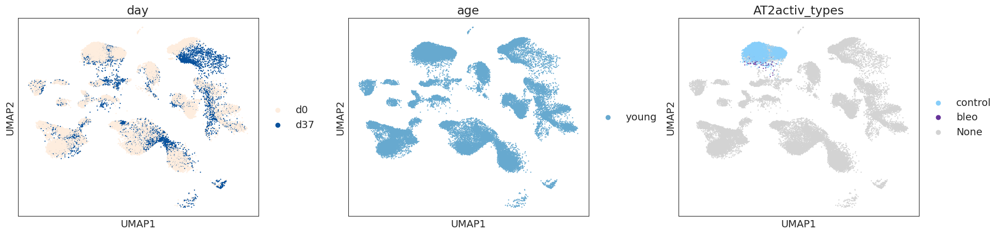

AT2_activated - d37
Running Myofibroblast Version
(7500, 4867)


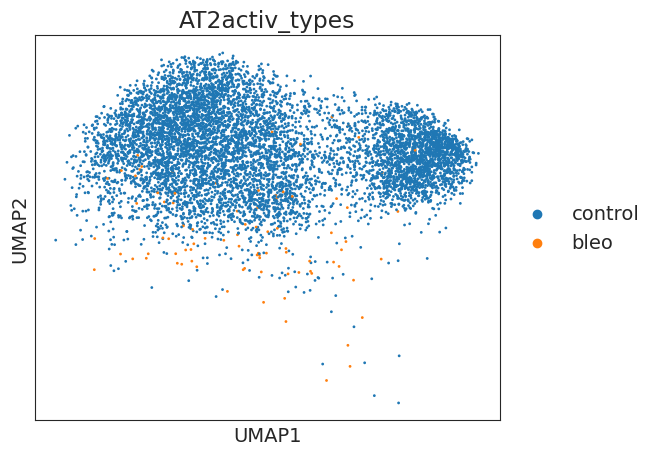

Started Diffxpy Calculation:	04-09-2024 15:58:38
training location model: True
training scale model: True
iter   0: ll=13674678.152067
caught 3 linalg singular matrix errors
iter   1: ll=12398798.314136, converged: 0.00% (loc: 0.39%, scale update: False), in 2.63sec
iter   2: ll=12122135.079558, converged: 0.00% (loc: 0.39%, scale update: False), in 2.66sec
iter   3: ll=12106591.632188, converged: 0.00% (loc: 0.39%, scale update: False), in 2.51sec
iter   4: ll=12106418.397254, converged: 0.00% (loc: 0.39%, scale update: False), in 2.41sec
iter   5: ll=12106411.974029, converged: 0.00% (loc: 1.89%, scale update: False), in 2.52sec
iter   6: ll=11565499.378411, converged: 0.00% (loc: 0.00%, scale update: True), in 32.30sec
caught 2 linalg singular matrix errors
iter   7: ll=11563854.228221, converged: 0.00% (loc: 0.08%, scale update: False), in 2.77sec
iter   8: ll=11563703.614972, converged: 0.00% (loc: 0.47%, scale update: False), in 2.57sec
iter   9: ll=11563678.635549, converged: 0.

In [20]:
condition = "AT2activ_types"
ct = "AT2_activated"

id1 = "control"
id2 = "bleo"
subset = ["control", "bleo"]
age = "young"
ct_label = "AT2activ_types"

for time in ["d3", "d10", "d20", "d30", "d37"]:
    time_subset = adata[(adata.obs.age == age) & (adata.obs.day.isin([time, "d0"]))].copy()
    sc.pl.umap(time_subset, color = ["day", "age", ct_label], size = 10, wspace = 0.25)

    ## Actually run the function
    print("%s - %s" %(ct, time))
    dge(time_subset, ct = ct, ct_label = ct_label, condition = condition, ref = "control", 
        pct_thresh = 0.05, subset = subset, min_cells = 10, suffix = "_%s" %age, myofib = True)

#### Myofibroblasts

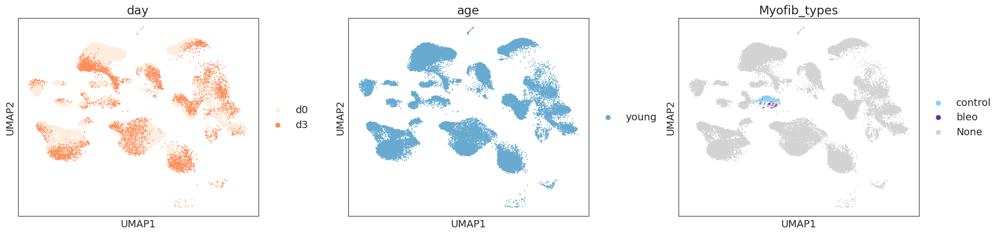

Myofibroblasts - d3
Running Myofibroblast Version
(487, 5894)


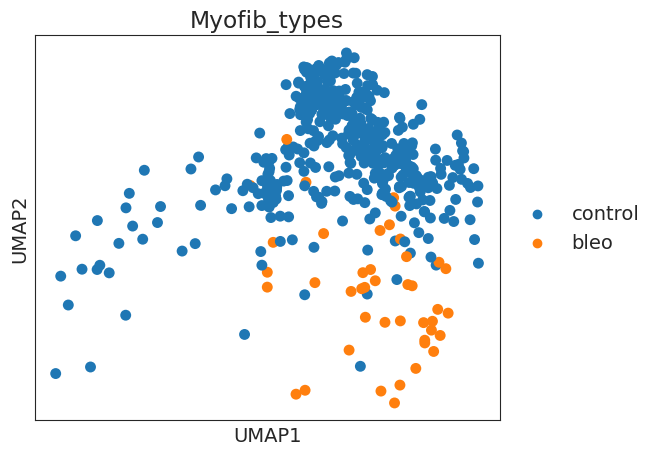

Started Diffxpy Calculation:	04-09-2024 16:02:24
training location model: True
training scale model: True
iter   0: ll=1398459.222631
caught 67 linalg singular matrix errors
iter   1: ll=1289826.929736, converged: 0.00% (loc: 2.21%, scale update: False), in 0.68sec
iter   2: ll=1262877.973467, converged: 0.00% (loc: 2.21%, scale update: False), in 0.74sec
iter   3: ll=1260440.898696, converged: 0.00% (loc: 2.21%, scale update: False), in 0.95sec
iter   4: ll=1260313.764990, converged: 0.00% (loc: 2.21%, scale update: False), in 0.74sec
iter   5: ll=1260301.247880, converged: 0.00% (loc: 2.48%, scale update: False), in 0.73sec
iter   6: ll=1092376.468243, converged: 0.00% (loc: 0.00%, scale update: True), in 5.32sec
caught 67 linalg singular matrix errors
iter   7: ll=1091601.529898, converged: 0.00% (loc: 1.26%, scale update: False), in 0.70sec
iter   8: ll=1091435.361723, converged: 0.00% (loc: 1.80%, scale update: False), in 0.70sec
iter   9: ll=1091403.628725, converged: 0.00% (loc:

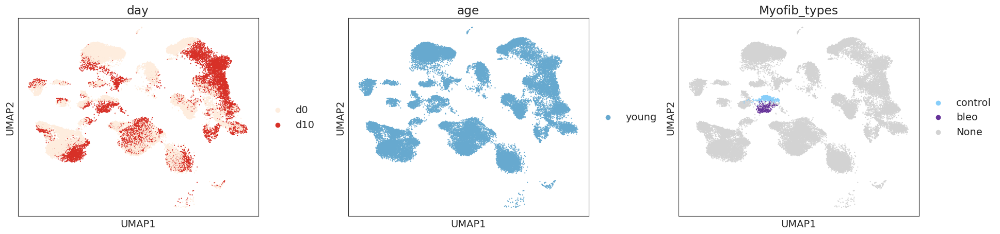

Myofibroblasts - d10
Running Myofibroblast Version
(702, 5657)


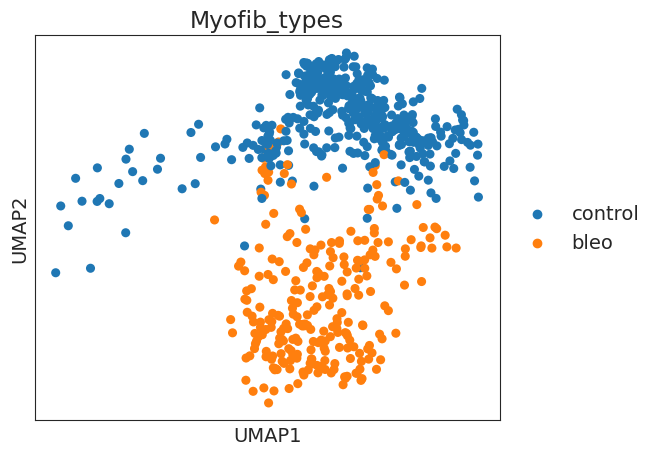

Started Diffxpy Calculation:	04-09-2024 16:03:36
training location model: True
training scale model: True
iter   0: ll=2151580.489716
caught 36 linalg singular matrix errors
iter   1: ll=1978431.876438, converged: 0.00% (loc: 0.95%, scale update: False), in 0.58sec
iter   2: ll=1933059.590856, converged: 0.00% (loc: 0.95%, scale update: False), in 0.64sec
iter   3: ll=1928572.008514, converged: 0.00% (loc: 0.95%, scale update: False), in 0.64sec
iter   4: ll=1928392.923171, converged: 0.00% (loc: 0.95%, scale update: False), in 0.81sec
iter   5: ll=1928384.880224, converged: 0.00% (loc: 1.08%, scale update: False), in 0.62sec
iter   6: ll=1708331.247104, converged: 0.00% (loc: 0.00%, scale update: True), in 6.14sec
caught 36 linalg singular matrix errors
iter   7: ll=1707577.237480, converged: 0.00% (loc: 0.65%, scale update: False), in 0.65sec
iter   8: ll=1707498.511487, converged: 0.00% (loc: 1.22%, scale update: False), in 0.63sec
iter   9: ll=1707494.554459, converged: 0.00% (loc:

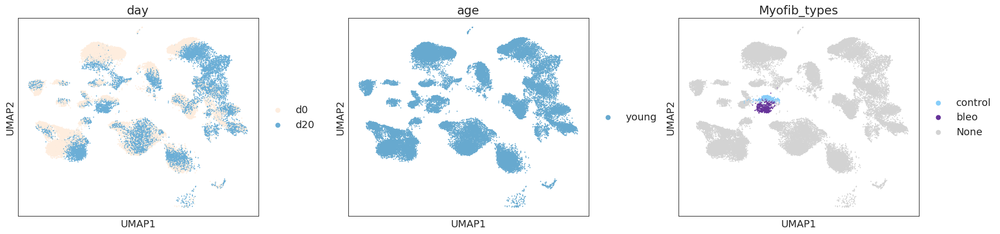

Myofibroblasts - d20
Running Myofibroblast Version
(900, 5719)


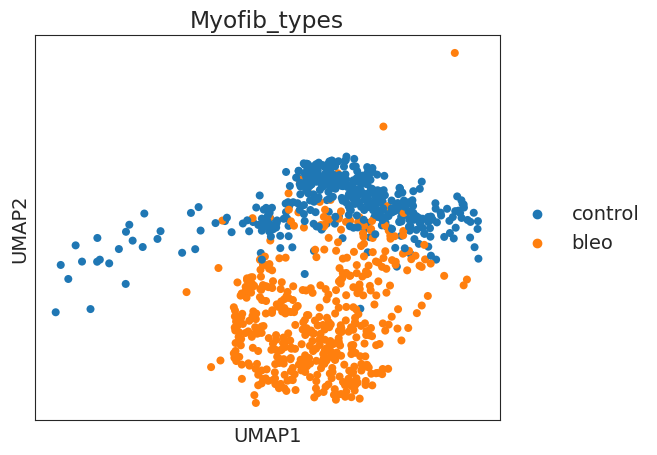

Started Diffxpy Calculation:	04-09-2024 16:04:40
training location model: True
training scale model: True
iter   0: ll=3501368.538573
caught 42 linalg singular matrix errors
iter   1: ll=3254562.311911, converged: 0.00% (loc: 1.40%, scale update: False), in 0.57sec
iter   2: ll=3178834.615434, converged: 0.00% (loc: 1.40%, scale update: False), in 0.74sec
iter   3: ll=3167803.036384, converged: 0.00% (loc: 1.40%, scale update: False), in 0.57sec
iter   4: ll=3166936.422336, converged: 0.00% (loc: 1.40%, scale update: False), in 0.60sec
iter   5: ll=3166875.761810, converged: 0.00% (loc: 1.42%, scale update: False), in 0.56sec
iter   6: ll=2467492.400901, converged: 0.00% (loc: 0.00%, scale update: True), in 7.15sec
caught 42 linalg singular matrix errors
iter   7: ll=2465705.368307, converged: 0.00% (loc: 0.79%, scale update: False), in 0.59sec
iter   8: ll=2465436.665198, converged: 0.00% (loc: 1.19%, scale update: False), in 0.77sec
iter   9: ll=2465405.109568, converged: 0.00% (loc:

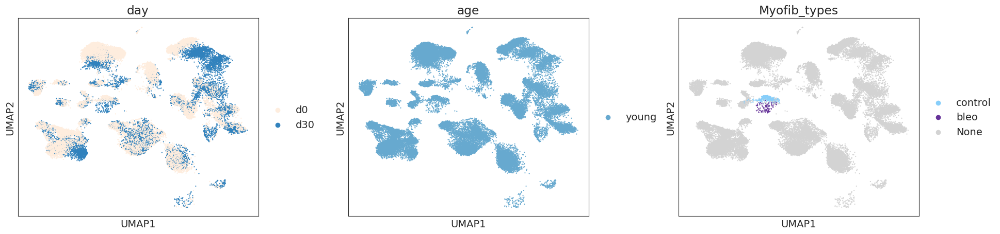

Myofibroblasts - d30
Running Myofibroblast Version
(560, 6531)


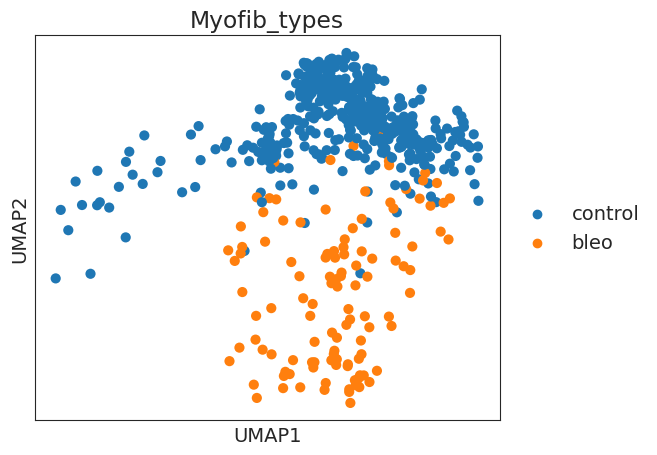

Started Diffxpy Calculation:	04-09-2024 16:05:56
training location model: True
training scale model: True
iter   0: ll=2338697.820050
caught 72 linalg singular matrix errors
iter   1: ll=2188097.066373, converged: 0.00% (loc: 2.82%, scale update: False), in 0.71sec
iter   2: ll=2145207.727500, converged: 0.00% (loc: 2.82%, scale update: False), in 0.76sec
iter   3: ll=2139413.253170, converged: 0.00% (loc: 2.82%, scale update: False), in 0.77sec
iter   4: ll=2138911.233369, converged: 0.00% (loc: 2.82%, scale update: False), in 0.78sec
iter   5: ll=2138865.437765, converged: 0.00% (loc: 2.82%, scale update: False), in 0.94sec
iter   6: ll=1494643.566695, converged: 0.00% (loc: 0.00%, scale update: True), in 6.24sec
caught 65 linalg singular matrix errors
iter   7: ll=1493654.697359, converged: 0.00% (loc: 1.29%, scale update: False), in 0.75sec
iter   8: ll=1493486.372542, converged: 0.00% (loc: 1.64%, scale update: False), in 0.75sec
iter   9: ll=1493462.484077, converged: 0.00% (loc:

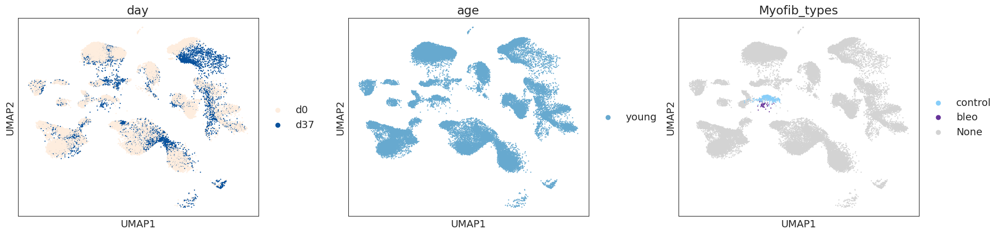

Myofibroblasts - d37
Running Myofibroblast Version
(483, 5185)


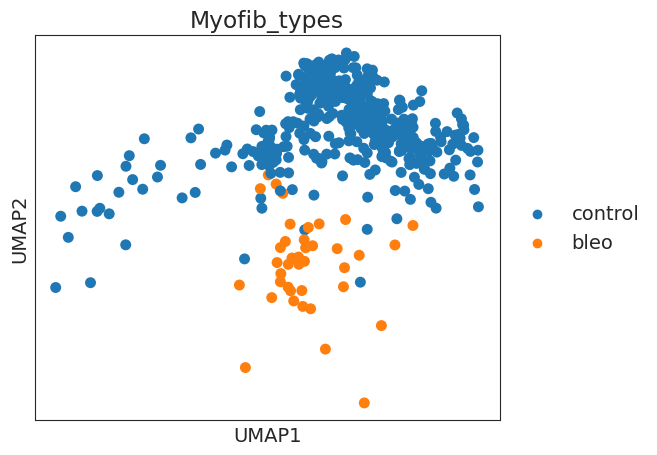

Started Diffxpy Calculation:	04-09-2024 16:07:16
training location model: True
training scale model: True
iter   0: ll=1129881.376105
caught 218 linalg singular matrix errors
iter   1: ll=1035598.373392, converged: 0.00% (loc: 4.44%, scale update: False), in 0.57sec
iter   2: ll=1013429.071767, converged: 0.00% (loc: 4.44%, scale update: False), in 0.62sec
iter   3: ll=1011830.792841, converged: 0.00% (loc: 4.44%, scale update: False), in 0.66sec
iter   4: ll=1011791.919011, converged: 0.00% (loc: 4.44%, scale update: False), in 0.68sec
iter   5: ll=1011789.430425, converged: 0.00% (loc: 5.09%, scale update: False), in 0.68sec
iter   6: ll=973756.722369, converged: 0.00% (loc: 0.00%, scale update: True), in 4.95sec
caught 218 linalg singular matrix errors
iter   7: ll=973498.227118, converged: 0.00% (loc: 4.28%, scale update: False), in 0.65sec
iter   8: ll=973468.192900, converged: 0.00% (loc: 5.38%, scale update: False), in 0.66sec
iter   9: ll=973463.492175, converged: 0.00% (loc: 1

In [21]:
condition = "Myofib_types"
id1 = "control"
id2 = "bleo"
subset = [id1, id2]
age = "young"
ct_label = "Myofib_types"

for time in ["d3", "d10", "d20", "d30", "d37"]:
    time_subset = adata[(adata.obs.age == age) & (adata.obs.day.isin([time, "d0"]))].copy()
    sc.pl.umap(time_subset, color = ["day", "age", ct_label], size = 10, wspace = 0.25)

    for ct in ["Myofibroblasts"]:
        print("%s - %s" %(ct, time))
        
        ## Actually run the function
        dge(time_subset, ct = ct, ct_label = ct_label, condition = condition, ref = "control",
            pct_thresh = 0.05, subset = subset, min_cells = 10, suffix = "_young", myofib = True)

#### Krt8 ADI

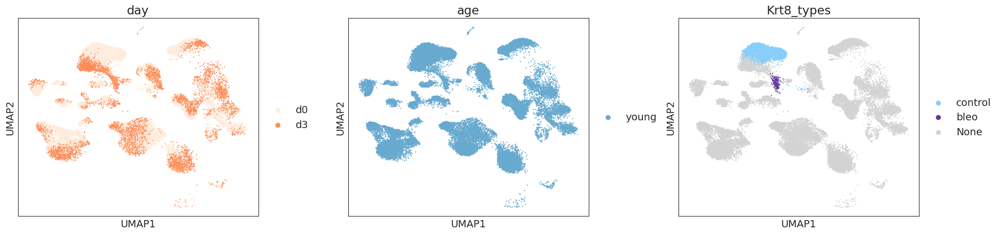

Krt8-ADI - d3
Running Myofibroblast Version
(7531, 5475)


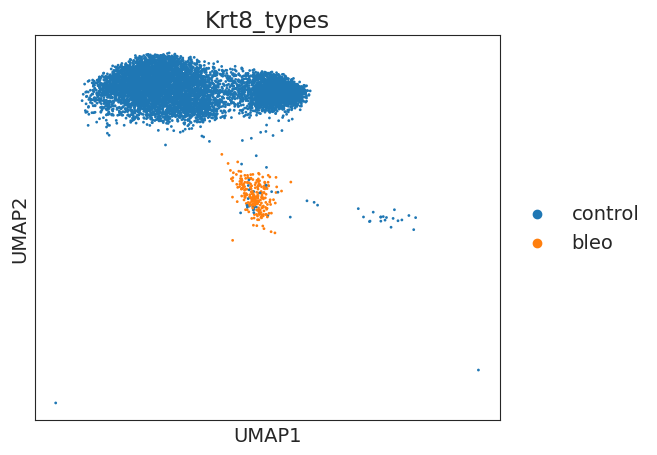

Started Diffxpy Calculation:	04-09-2024 16:09:02
training location model: True
training scale model: True
iter   0: ll=13753642.952958
caught 13 linalg singular matrix errors
iter   1: ll=12502270.630514, converged: 0.00% (loc: 0.37%, scale update: False), in 2.93sec
iter   2: ll=12232433.600644, converged: 0.00% (loc: 0.37%, scale update: False), in 2.77sec
iter   3: ll=12217821.688058, converged: 0.00% (loc: 0.37%, scale update: False), in 2.83sec
iter   4: ll=12217725.302192, converged: 0.00% (loc: 0.37%, scale update: False), in 2.99sec
iter   5: ll=12217724.565946, converged: 0.00% (loc: 6.03%, scale update: False), in 2.79sec
iter   6: ll=11910396.371592, converged: 0.00% (loc: 0.00%, scale update: True), in 36.66sec
caught 13 linalg singular matrix errors
iter   7: ll=11909003.549906, converged: 0.00% (loc: 0.26%, scale update: False), in 2.99sec
iter   8: ll=11908949.524696, converged: 0.00% (loc: 0.66%, scale update: False), in 3.11sec
iter   9: ll=11908939.410892, converged: 

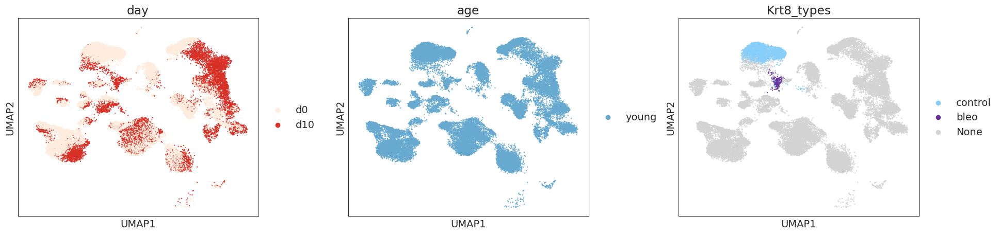

Krt8-ADI - d10
Running Myofibroblast Version
(7588, 5165)


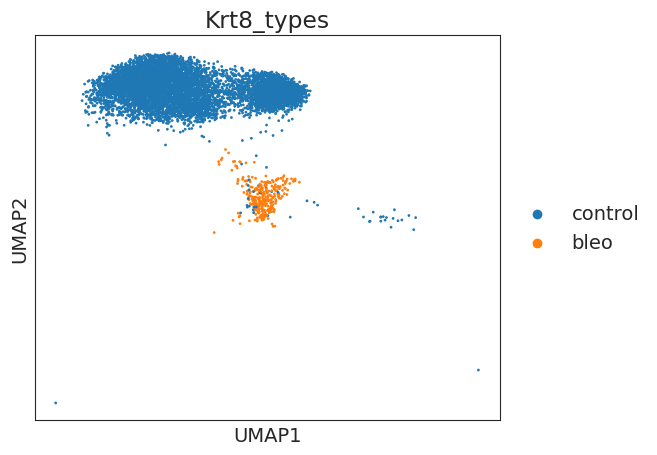

Started Diffxpy Calculation:	04-09-2024 16:12:27
training location model: True
training scale model: True
iter   0: ll=13573671.601018
caught 14 linalg singular matrix errors
iter   1: ll=12343683.445278, converged: 0.00% (loc: 0.29%, scale update: False), in 2.69sec
iter   2: ll=12075657.549960, converged: 0.00% (loc: 0.29%, scale update: False), in 2.74sec
iter   3: ll=12060567.434454, converged: 0.00% (loc: 0.29%, scale update: False), in 2.79sec
iter   4: ll=12060406.426120, converged: 0.00% (loc: 0.29%, scale update: False), in 2.57sec
iter   5: ll=12060398.575721, converged: 0.00% (loc: 3.35%, scale update: False), in 2.79sec
iter   6: ll=11810363.875820, converged: 0.00% (loc: 0.00%, scale update: True), in 34.56sec
caught 14 linalg singular matrix errors
iter   7: ll=11808911.719963, converged: 0.00% (loc: 0.29%, scale update: False), in 2.76sec
iter   8: ll=11808865.371615, converged: 0.00% (loc: 0.54%, scale update: False), in 2.63sec
iter   9: ll=11808862.915005, converged: 

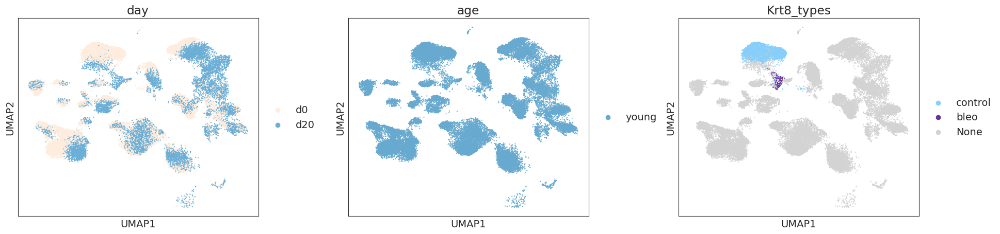

Krt8-ADI - d20
Running Myofibroblast Version
(7434, 5189)


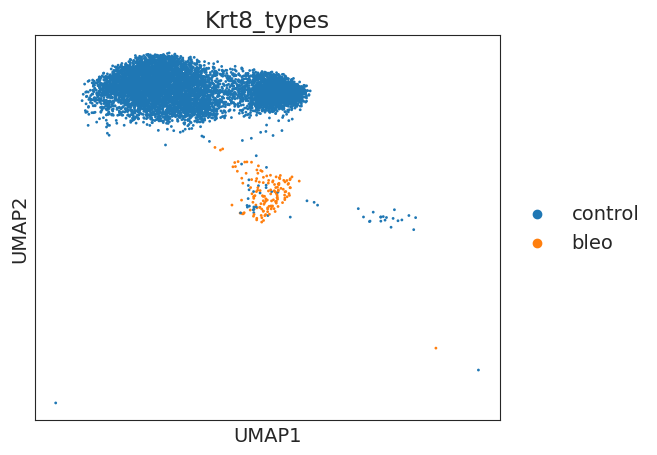

Started Diffxpy Calculation:	04-09-2024 16:15:48
training location model: True
training scale model: True
iter   0: ll=13278979.243107
caught 20 linalg singular matrix errors
iter   1: ll=12065855.699196, converged: 0.00% (loc: 0.62%, scale update: False), in 2.80sec
iter   2: ll=11802254.276760, converged: 0.00% (loc: 0.62%, scale update: False), in 2.70sec
iter   3: ll=11787416.611598, converged: 0.00% (loc: 0.62%, scale update: False), in 2.56sec
iter   4: ll=11787216.985315, converged: 0.00% (loc: 0.62%, scale update: False), in 2.62sec
iter   5: ll=11787201.106121, converged: 0.00% (loc: 2.74%, scale update: False), in 2.84sec
iter   6: ll=11435996.391344, converged: 0.00% (loc: 0.00%, scale update: True), in 33.85sec
caught 20 linalg singular matrix errors
iter   7: ll=11434290.147198, converged: 0.00% (loc: 0.42%, scale update: False), in 2.79sec
iter   8: ll=11434160.873284, converged: 0.00% (loc: 0.75%, scale update: False), in 2.69sec
iter   9: ll=11434145.574990, converged: 

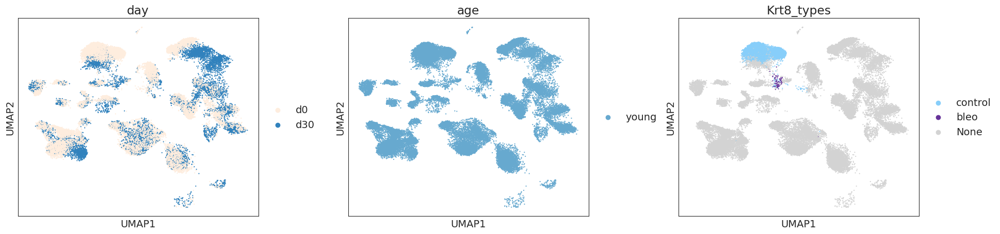

Krt8-ADI - d30
Running Myofibroblast Version
(7380, 5588)


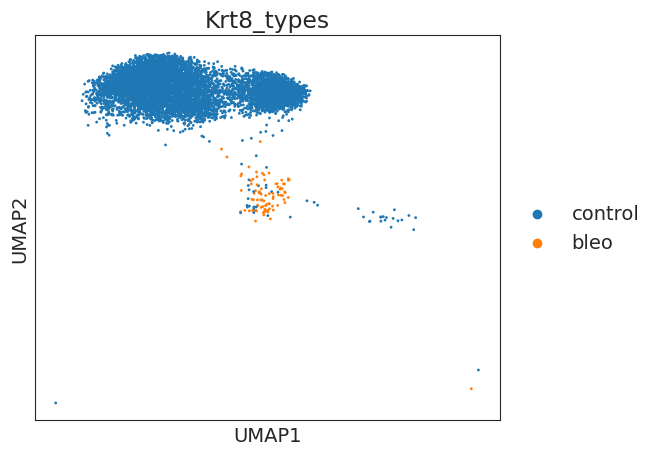

Started Diffxpy Calculation:	04-09-2024 16:19:37
training location model: True
training scale model: True
iter   0: ll=13682454.045761
caught 26 linalg singular matrix errors
iter   1: ll=12458383.084797, converged: 0.00% (loc: 1.15%, scale update: False), in 2.88sec
iter   2: ll=12192565.345540, converged: 0.00% (loc: 1.15%, scale update: False), in 2.97sec
iter   3: ll=12177311.952349, converged: 0.00% (loc: 1.15%, scale update: False), in 2.71sec
iter   4: ll=12177015.113788, converged: 0.00% (loc: 1.15%, scale update: False), in 2.70sec
iter   5: ll=12176981.362464, converged: 0.00% (loc: 3.26%, scale update: False), in 2.67sec
iter   6: ll=11604623.357980, converged: 0.00% (loc: 0.00%, scale update: True), in 36.16sec
caught 25 linalg singular matrix errors
iter   7: ll=11602243.519923, converged: 0.00% (loc: 0.54%, scale update: False), in 2.81sec
iter   8: ll=11601941.849413, converged: 0.00% (loc: 0.75%, scale update: False), in 3.04sec
iter   9: ll=11601892.047030, converged: 

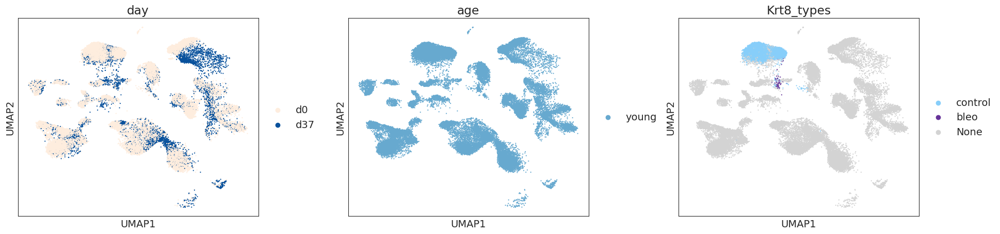

Krt8-ADI - d37
Running Myofibroblast Version
(7363, 3495)


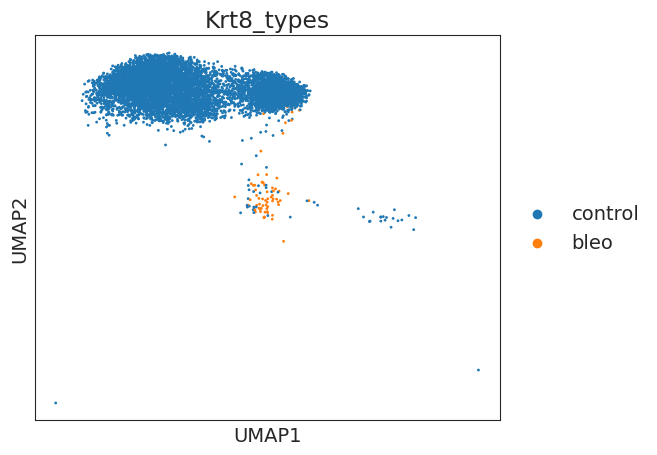

Started Diffxpy Calculation:	04-09-2024 16:23:40
training location model: True
training scale model: True
iter   0: ll=11375209.418932
caught 111 linalg singular matrix errors
iter   1: ll=10301294.977104, converged: 0.00% (loc: 3.40%, scale update: False), in 1.89sec
iter   2: ll=10068833.748154, converged: 0.00% (loc: 3.40%, scale update: False), in 1.73sec
iter   3: ll=10056395.224101, converged: 0.00% (loc: 3.40%, scale update: False), in 1.71sec
iter   4: ll=10056323.033186, converged: 0.00% (loc: 3.40%, scale update: False), in 1.69sec
iter   5: ll=10056322.727326, converged: 0.00% (loc: 16.80%, scale update: False), in 1.70sec
iter   6: ll=9829157.749386, converged: 0.00% (loc: 0.00%, scale update: True), in 23.89sec
caught 111 linalg singular matrix errors
iter   7: ll=9828495.797096, converged: 0.00% (loc: 3.26%, scale update: False), in 1.86sec
iter   8: ll=9828486.059855, converged: 0.00% (loc: 4.41%, scale update: False), in 1.63sec
iter   9: ll=9828486.000213, converged: 0

In [23]:
condition = "Krt8_types"
ct = "Krt8-ADI"

id1 = "control"
id2 = "bleo"
subset = [id1, id2]
age = "young"
ct_label = "Krt8_types"

for time in ["d3", "d10", "d20", "d30", "d37"]:
    time_subset = adata[(adata.obs.age == age) & (adata.obs.day.isin([time, "d0"]))].copy()
    sc.pl.umap(time_subset, color = ["day", "age", ct_label], size = 10, wspace = 0.25)

    ## Actually run the function
    print("%s - %s" %(ct, time))
    dge(time_subset, ct = ct, ct_label = ct_label, condition = condition, ref = subset[0],
        pct_thresh = 0.05, subset = subset, min_cells = 10, suffix = "_%s" %age, myofib = True)

#### AT1

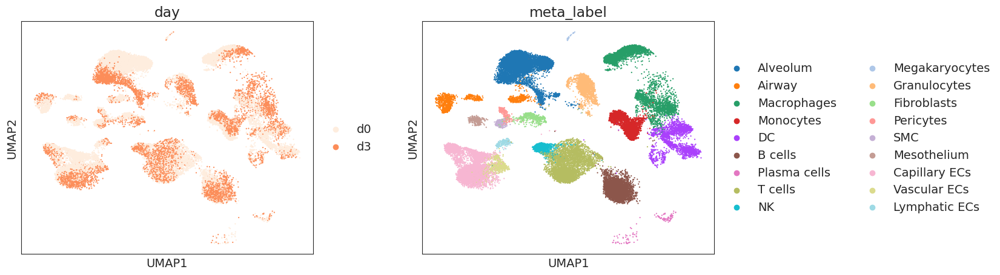

AT1 - d3
(120, 5428)


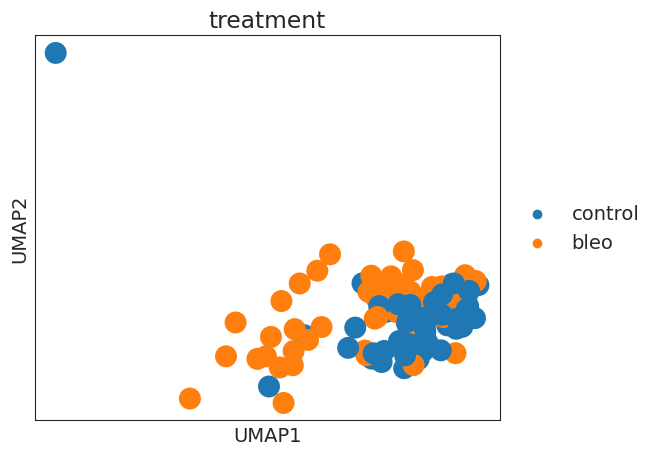

Started Diffxpy Calculation:	04-09-2024 17:11:44
training location model: True
training scale model: True
iter   0: ll=3399086.483348
caught 106 linalg singular matrix errors
iter   1: ll=3345479.188086, converged: 0.00% (loc: 18.88%, scale update: False), in 0.61sec
iter   2: ll=3330388.275073, converged: 0.00% (loc: 18.88%, scale update: False), in 0.65sec
iter   3: ll=3328292.309605, converged: 0.00% (loc: 18.88%, scale update: False), in 0.67sec
iter   4: ll=3328123.228088, converged: 0.00% (loc: 18.88%, scale update: False), in 0.67sec
iter   5: ll=3328111.693712, converged: 0.00% (loc: 18.96%, scale update: False), in 0.83sec
iter   6: ll=457938.673644, converged: 0.00% (loc: 0.00%, scale update: True), in 3.72sec
caught 103 linalg singular matrix errors
iter   7: ll=449863.263497, converged: 0.00% (loc: 3.10%, scale update: False), in 0.65sec
iter   8: ll=448070.799002, converged: 0.00% (loc: 4.05%, scale update: False), in 0.67sec
iter   9: ll=447879.844504, converged: 0.00% (l

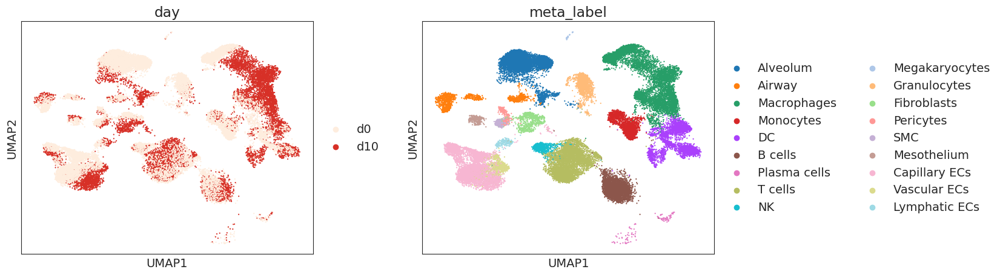

AT1 - d10
(118, 4895)


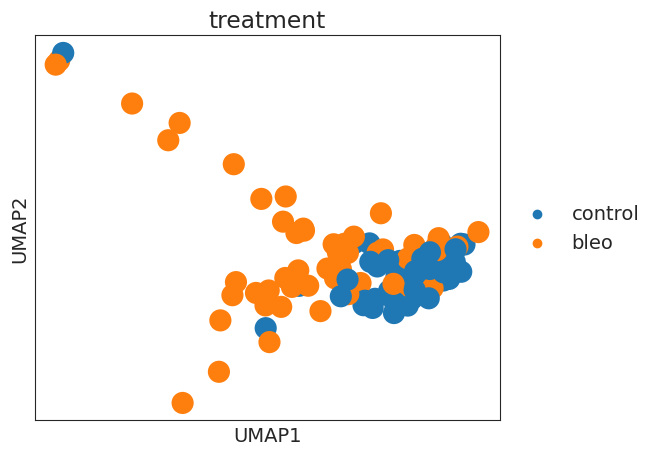

Started Diffxpy Calculation:	04-09-2024 17:12:49
training location model: True
training scale model: True
iter   0: ll=1580335.664881
caught 105 linalg singular matrix errors
iter   1: ll=1544961.961527, converged: 0.00% (loc: 11.54%, scale update: False), in 0.53sec
iter   2: ll=1535526.409760, converged: 0.00% (loc: 11.54%, scale update: False), in 0.61sec
iter   3: ll=1534431.132695, converged: 0.00% (loc: 11.54%, scale update: False), in 0.59sec
iter   4: ll=1534366.601912, converged: 0.00% (loc: 11.54%, scale update: False), in 0.80sec
iter   5: ll=1534362.981174, converged: 0.00% (loc: 11.73%, scale update: False), in 0.62sec
iter   6: ll=332649.261801, converged: 0.00% (loc: 0.00%, scale update: True), in 3.31sec
caught 103 linalg singular matrix errors
iter   7: ll=329590.683198, converged: 0.00% (loc: 2.90%, scale update: False), in 0.63sec
iter   8: ll=329004.523842, converged: 0.00% (loc: 3.70%, scale update: False), in 0.63sec
iter   9: ll=328940.582888, converged: 0.00% (l

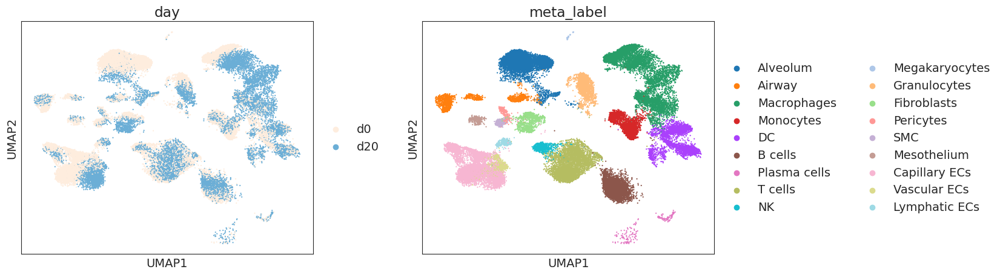

AT1 - d20
(153, 4919)


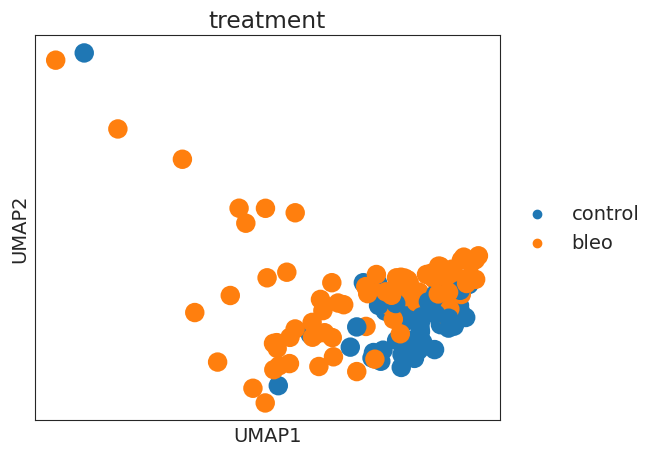

Started Diffxpy Calculation:	04-09-2024 17:13:50
training location model: True
training scale model: True
iter   0: ll=1979550.376551
caught 119 linalg singular matrix errors
iter   1: ll=1930070.693770, converged: 0.00% (loc: 11.20%, scale update: False), in 0.51sec
iter   2: ll=1916306.468061, converged: 0.00% (loc: 11.20%, scale update: False), in 0.54sec
iter   3: ll=1914576.310126, converged: 0.00% (loc: 11.20%, scale update: False), in 0.61sec
iter   4: ll=1914463.312372, converged: 0.00% (loc: 11.20%, scale update: False), in 0.62sec
iter   5: ll=1914456.649440, converged: 0.00% (loc: 11.28%, scale update: False), in 0.63sec
iter   6: ll=426142.449003, converged: 0.00% (loc: 0.00%, scale update: True), in 3.77sec
caught 118 linalg singular matrix errors
iter   7: ll=422170.603928, converged: 0.00% (loc: 3.33%, scale update: False), in 0.66sec
iter   8: ll=421366.536179, converged: 0.00% (loc: 4.11%, scale update: False), in 0.65sec
iter   9: ll=421277.612682, converged: 0.00% (l

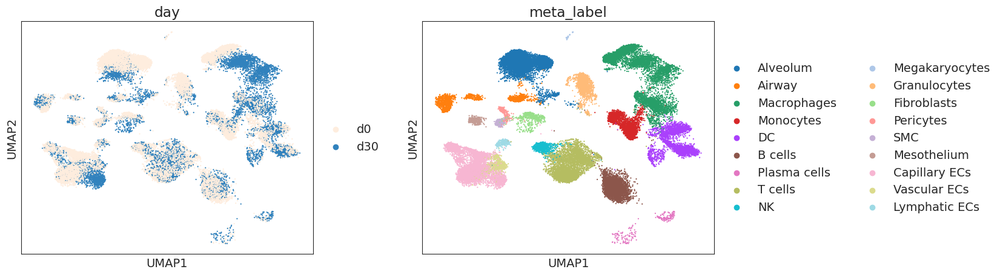

AT1 - d30
(125, 5006)


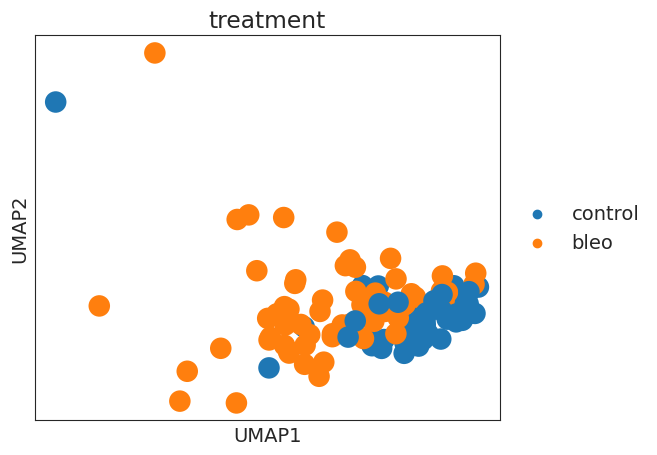

Started Diffxpy Calculation:	04-09-2024 17:14:54
training location model: True
training scale model: True
iter   0: ll=2620322.175701
caught 115 linalg singular matrix errors
iter   1: ll=2574939.466898, converged: 0.00% (loc: 15.58%, scale update: False), in 0.55sec
iter   2: ll=2560582.153723, converged: 0.00% (loc: 15.58%, scale update: False), in 0.62sec
iter   3: ll=2558108.888345, converged: 0.00% (loc: 15.58%, scale update: False), in 0.64sec
iter   4: ll=2557835.039681, converged: 0.00% (loc: 15.58%, scale update: False), in 0.64sec
iter   5: ll=2557808.660662, converged: 0.00% (loc: 15.58%, scale update: False), in 0.64sec
iter   6: ll=430290.539828, converged: 0.02% (loc: 0.02%, scale update: True), in 3.43sec
caught 111 linalg singular matrix errors
iter   7: ll=425899.582695, converged: 0.02% (loc: 3.34%, scale update: False), in 0.66sec
iter   8: ll=425019.959217, converged: 0.02% (loc: 3.98%, scale update: False), in 0.81sec
iter   9: ll=424930.205035, converged: 0.02% (l

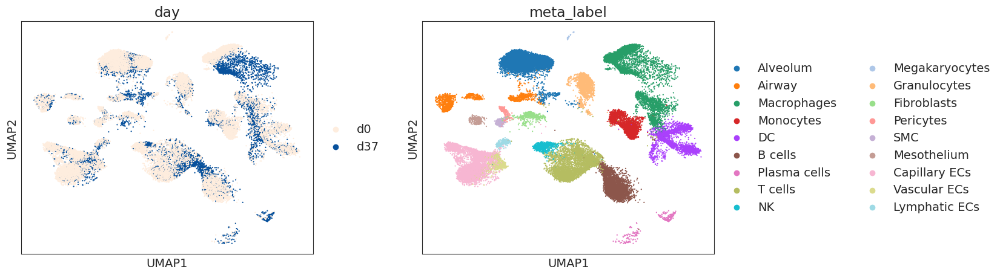

AT1 - d37
(101, 4328)


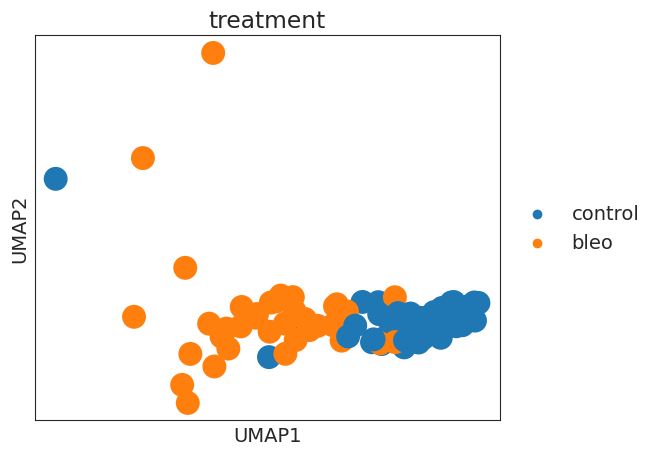

Started Diffxpy Calculation:	04-09-2024 17:15:59
training location model: True
training scale model: True
iter   0: ll=1161149.697599
caught 226 linalg singular matrix errors
iter   1: ll=1133052.726204, converged: 0.00% (loc: 13.22%, scale update: False), in 0.48sec
iter   2: ll=1126278.284228, converged: 0.00% (loc: 13.22%, scale update: False), in 0.52sec
iter   3: ll=1125630.826508, converged: 0.00% (loc: 13.22%, scale update: False), in 0.51sec
iter   4: ll=1125602.983445, converged: 0.00% (loc: 13.22%, scale update: False), in 0.52sec
iter   5: ll=1125601.908327, converged: 0.00% (loc: 13.75%, scale update: False), in 0.51sec
iter   6: ll=250837.461594, converged: 0.00% (loc: 0.00%, scale update: True), in 3.02sec
caught 226 linalg singular matrix errors
iter   7: ll=249152.867594, converged: 0.00% (loc: 5.91%, scale update: False), in 0.72sec
iter   8: ll=248823.649956, converged: 0.00% (loc: 7.49%, scale update: False), in 0.54sec
iter   9: ll=248798.212564, converged: 0.00% (l

In [32]:
subset = ["control", "bleo"]
condition = "treatment"
ct_label = "cell_type"
min_cells = 10
age = "young"
cell_types = ["AT1"]
for time in ["d3", "d10", "d20", "d30", "d37"]:
    time_subset = adata[(adata.obs.age == age) & (adata.obs.day.isin([time, "d0"]))].copy()
    for ct in cell_types:
        sc.pl.umap(time_subset, color = ["day", "meta_label"], size = 10, wspace = 0.25)
        print("%s - %s" %(ct, time))
        dge(time_subset, ct = ct, ct_label = ct_label, condition = condition, ref = "control", pct_thresh = 0.05,
              subset = subset, min_cells = min_cells, do_return = False, suffix = "_young")

#### AT2

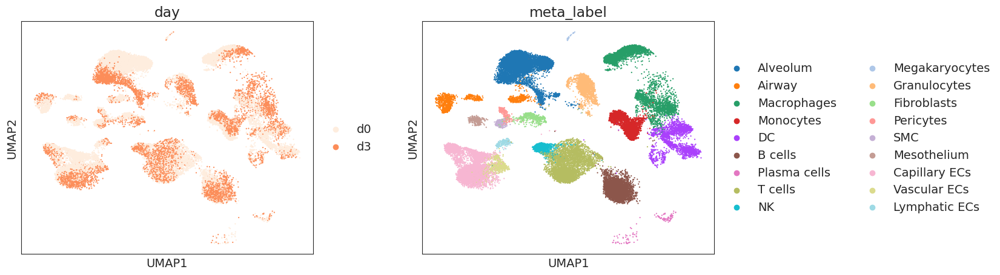

AT2 - d3
(7482, 3238)


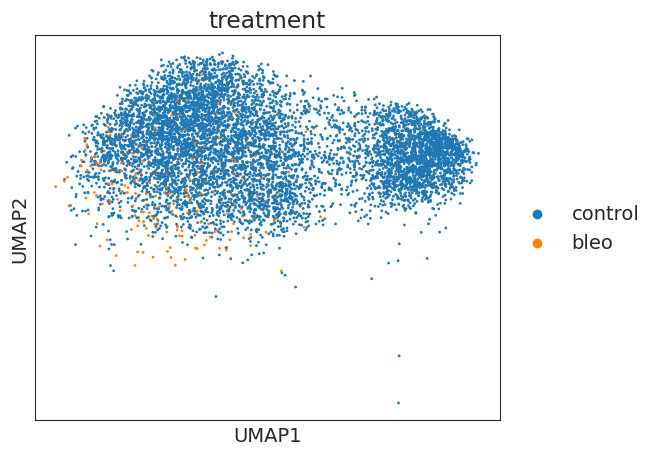

Started Diffxpy Calculation:	04-09-2024 16:32:56
training location model: True
training scale model: True
iter   0: ll=11595771.496768
iter   1: ll=10428295.380221, converged: 0.00% (loc: 0.00%, scale update: False), in 1.71sec
iter   2: ll=10177876.223039, converged: 0.00% (loc: 0.00%, scale update: False), in 1.82sec
iter   3: ll=10164684.704268, converged: 0.00% (loc: 0.00%, scale update: False), in 1.79sec
iter   4: ll=10164616.133328, converged: 0.00% (loc: 0.00%, scale update: False), in 1.79sec
iter   5: ll=10164616.065494, converged: 0.00% (loc: 12.26%, scale update: False), in 1.69sec
iter   6: ll=10011693.433605, converged: 0.00% (loc: 0.00%, scale update: True), in 23.22sec
iter   7: ll=10011105.591802, converged: 0.00% (loc: 0.03%, scale update: False), in 1.73sec
iter   8: ll=10011103.431472, converged: 0.00% (loc: 2.44%, scale update: False), in 1.81sec
iter   9: ll=10011103.424465, converged: 0.00% (loc: 31.44%, scale update: False), in 1.71sec
iter  10: ll=10011103.4243

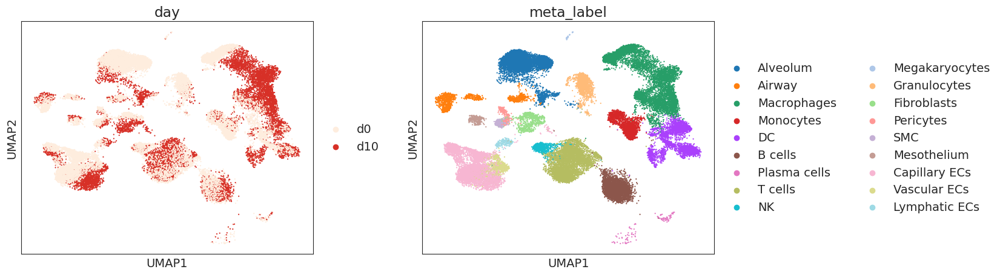

AT2 - d10
(7348, 2573)


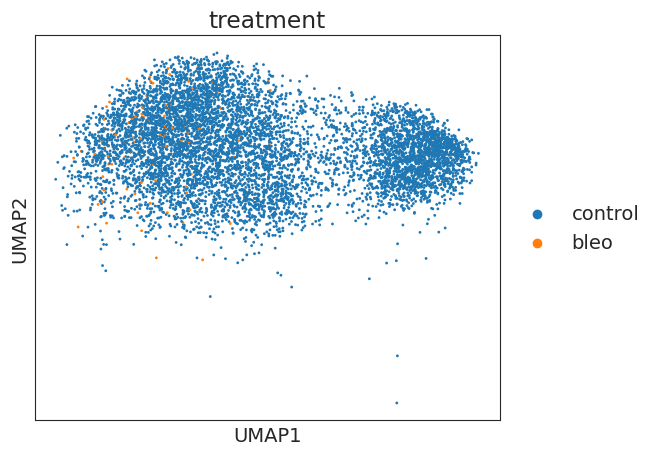

Started Diffxpy Calculation:	04-09-2024 16:34:58
training location model: True
training scale model: True
iter   0: ll=10356229.103656
caught 32 linalg singular matrix errors
iter   1: ll=9292245.250113, converged: 0.00% (loc: 1.24%, scale update: False), in 1.51sec
iter   2: ll=9061940.423906, converged: 0.00% (loc: 1.24%, scale update: False), in 1.50sec
iter   3: ll=9049685.675124, converged: 0.00% (loc: 1.24%, scale update: False), in 1.52sec
iter   4: ll=9049621.592664, converged: 0.00% (loc: 1.24%, scale update: False), in 1.44sec
iter   5: ll=9049621.531201, converged: 0.00% (loc: 9.83%, scale update: False), in 1.56sec
iter   6: ll=8918887.716994, converged: 0.00% (loc: 0.00%, scale update: True), in 17.96sec
caught 32 linalg singular matrix errors
iter   7: ll=8918412.101397, converged: 0.00% (loc: 1.32%, scale update: False), in 1.47sec
iter   8: ll=8918410.282150, converged: 0.00% (loc: 4.51%, scale update: False), in 1.42sec
iter   9: ll=8918410.272616, converged: 0.00% (lo

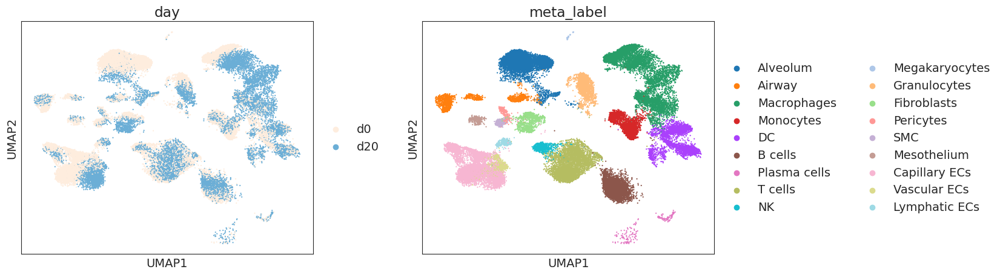

AT2 - d20
(7305, 2908)


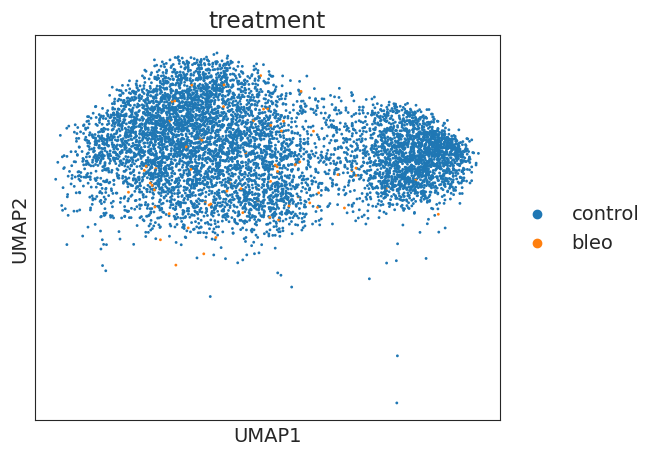

Started Diffxpy Calculation:	04-09-2024 16:36:33
training location model: True
training scale model: True
iter   0: ll=10746150.048735
caught 29 linalg singular matrix errors
iter   1: ll=9653924.976823, converged: 0.00% (loc: 1.00%, scale update: False), in 1.68sec
iter   2: ll=9418577.564678, converged: 0.00% (loc: 1.00%, scale update: False), in 1.53sec
iter   3: ll=9406115.315816, converged: 0.00% (loc: 1.00%, scale update: False), in 1.52sec
iter   4: ll=9406049.899385, converged: 0.00% (loc: 1.00%, scale update: False), in 1.62sec
iter   5: ll=9406049.828422, converged: 0.00% (loc: 12.76%, scale update: False), in 1.49sec
iter   6: ll=9270473.592804, converged: 0.00% (loc: 0.00%, scale update: True), in 20.06sec
caught 29 linalg singular matrix errors
iter   7: ll=9269959.604044, converged: 0.00% (loc: 1.07%, scale update: False), in 1.69sec
iter   8: ll=9269957.585863, converged: 0.00% (loc: 3.61%, scale update: False), in 1.59sec
iter   9: ll=9269957.577242, converged: 0.00% (l

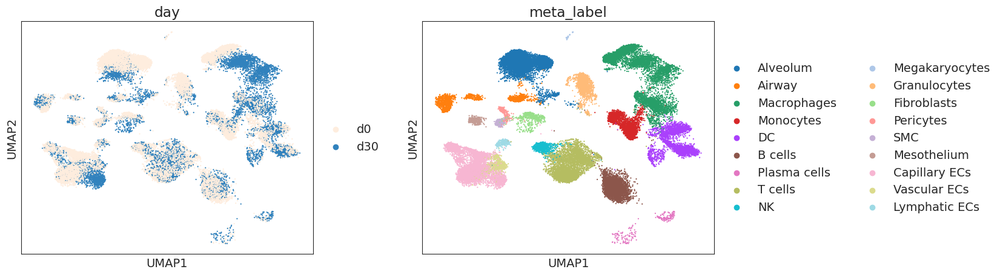

AT2 - d30
(7490, 3874)


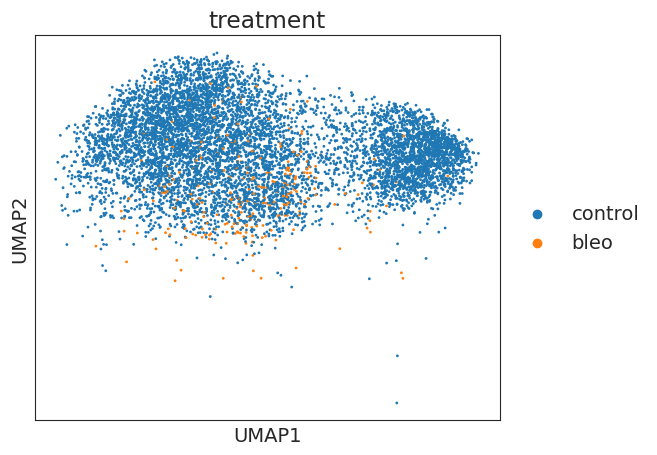

Started Diffxpy Calculation:	04-09-2024 16:38:19
training location model: True
training scale model: True
iter   0: ll=12489772.459733
iter   1: ll=11256944.844744, converged: 0.00% (loc: 0.00%, scale update: False), in 2.11sec
iter   2: ll=10989918.003468, converged: 0.00% (loc: 0.00%, scale update: False), in 2.07sec
iter   3: ll=10975265.467418, converged: 0.00% (loc: 0.00%, scale update: False), in 1.97sec
iter   4: ll=10975164.230879, converged: 0.00% (loc: 0.00%, scale update: False), in 2.08sec
iter   5: ll=10975163.741050, converged: 0.00% (loc: 1.37%, scale update: False), in 1.96sec
iter   6: ll=10810366.130182, converged: 0.00% (loc: 0.00%, scale update: True), in 26.58sec
iter   7: ll=10809351.372817, converged: 0.00% (loc: 0.05%, scale update: False), in 1.83sec
iter   8: ll=10809331.393160, converged: 0.00% (loc: 0.65%, scale update: False), in 2.01sec
iter   9: ll=10809330.797287, converged: 0.00% (loc: 4.47%, scale update: False), in 1.97sec
iter  10: ll=10809330.777085

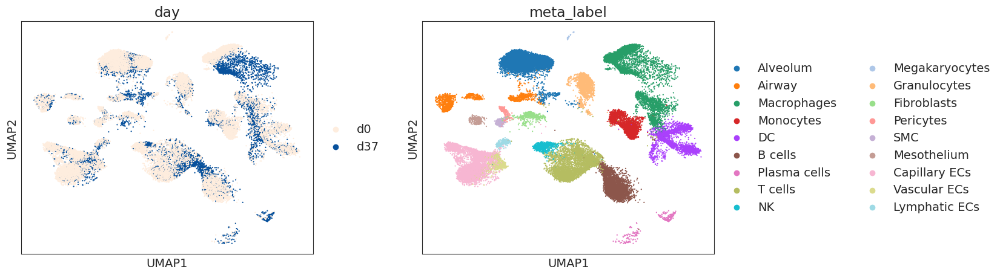

AT2 - d37
(8158, 2643)


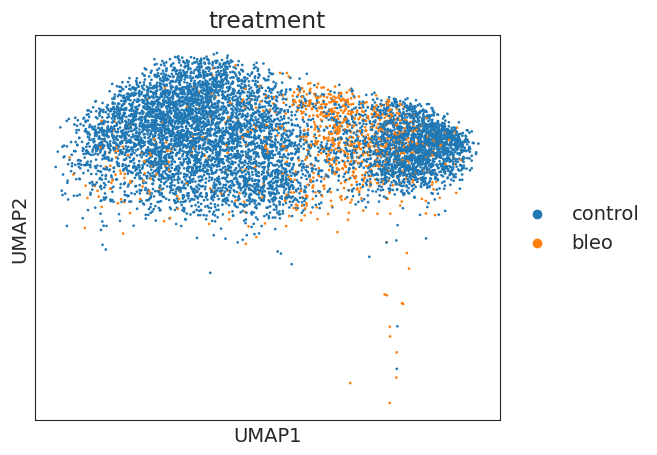

Started Diffxpy Calculation:	04-09-2024 16:40:42
training location model: True
training scale model: True
iter   0: ll=11477925.172344
caught 1 linalg singular matrix errors
iter   1: ll=10331946.916485, converged: 0.00% (loc: 0.04%, scale update: False), in 1.56sec
iter   2: ll=10080697.280562, converged: 0.00% (loc: 0.04%, scale update: False), in 1.49sec
iter   3: ll=10067008.210768, converged: 0.00% (loc: 0.04%, scale update: False), in 1.84sec
iter   4: ll=10066930.952418, converged: 0.00% (loc: 0.04%, scale update: False), in 1.70sec
iter   5: ll=10066930.851912, converged: 0.00% (loc: 6.32%, scale update: False), in 1.68sec
iter   6: ll=9901811.378462, converged: 0.00% (loc: 0.00%, scale update: True), in 20.36sec
caught 1 linalg singular matrix errors
iter   7: ll=9901156.834030, converged: 0.00% (loc: 0.04%, scale update: False), in 1.76sec
iter   8: ll=9901153.668638, converged: 0.00% (loc: 1.97%, scale update: False), in 1.69sec
iter   9: ll=9901153.653964, converged: 0.00% 

In [30]:
subset = ["control", "bleo"]
condition = "treatment"
ct_label = "cell_type"
min_cells = 10
age = "young"
cell_types = ["AT2"]
for time in ["d3", "d10", "d20", "d30", "d37"]:
    time_subset = adata[(adata.obs.age == age) & (adata.obs.day.isin([time, "d0"]))].copy()
    for ct in cell_types:
        sc.pl.umap(time_subset, color = ["day", "meta_label"], size = 10, wspace = 0.25)
        print("%s - %s" %(ct, time))
        dge(time_subset, ct = ct, ct_label = ct_label, condition = condition, ref = "control", pct_thresh = 0.05,
              subset = subset, min_cells = min_cells, do_return = False, suffix = "_young")

### Old Mice

In [33]:
out_folder = "/media/HDD_1/Janine/Aging_SingleCell/data/DGE_data/dge_targeted_old/"

#### Myofibroblasts

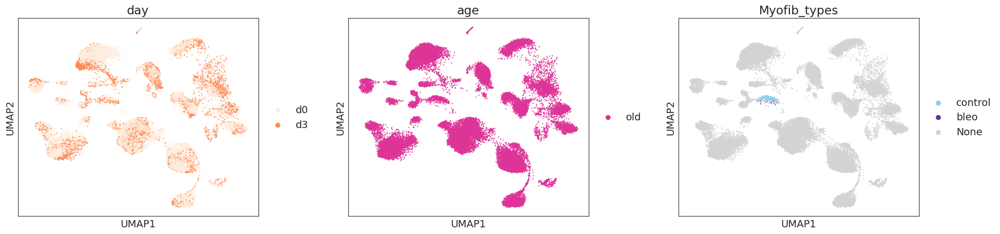

Myofibroblasts - d3
Running Myofibroblast Version
(313, 5699)


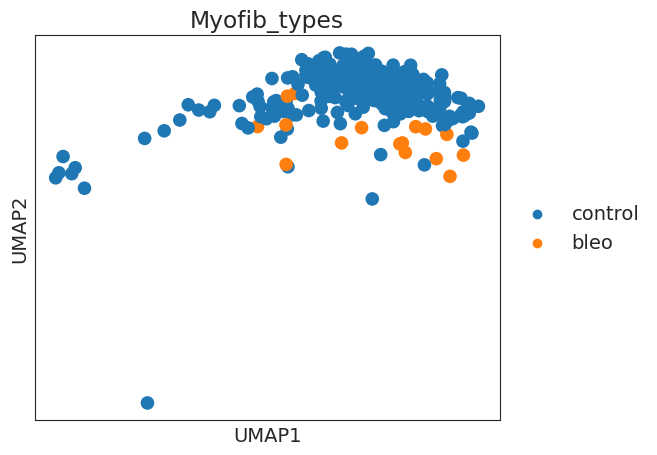

Started Diffxpy Calculation:	04-09-2024 17:48:54
training location model: True
training scale model: True
iter   0: ll=989593.525991
caught 873 linalg singular matrix errors
iter   1: ll=922757.762177, converged: 0.00% (loc: 16.49%, scale update: False), in 0.59sec
iter   2: ll=908418.156246, converged: 0.00% (loc: 16.49%, scale update: False), in 0.67sec
iter   3: ll=907570.013122, converged: 0.00% (loc: 16.49%, scale update: False), in 0.73sec
iter   4: ll=907558.512446, converged: 0.00% (loc: 16.49%, scale update: False), in 0.73sec
iter   5: ll=907558.241004, converged: 0.00% (loc: 20.28%, scale update: False), in 0.73sec
iter   6: ll=720176.528584, converged: 0.00% (loc: 0.00%, scale update: True), in 5.09sec
caught 873 linalg singular matrix errors
iter   7: ll=719850.920829, converged: 0.00% (loc: 16.23%, scale update: False), in 0.73sec
iter   8: ll=719818.677779, converged: 0.00% (loc: 18.41%, scale update: False), in 0.76sec
iter   9: ll=719817.822555, converged: 0.00% (loc: 

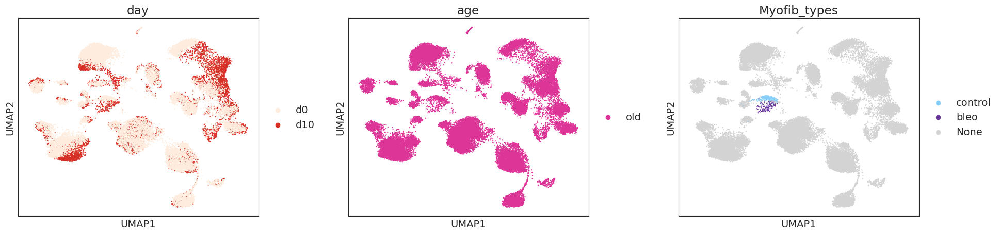

Myofibroblasts - d10
Running Myofibroblast Version
(411, 7077)


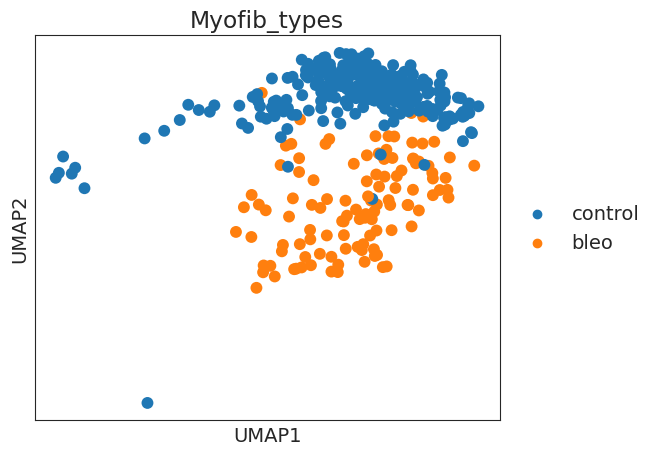

Started Diffxpy Calculation:	04-09-2024 17:49:55
training location model: True
training scale model: True
iter   0: ll=4442572.791197
caught 103 linalg singular matrix errors
iter   1: ll=4285231.668813, converged: 0.00% (loc: 8.29%, scale update: False), in 0.79sec
iter   2: ll=4236887.080899, converged: 0.00% (loc: 8.29%, scale update: False), in 1.03sec
iter   3: ll=4227833.122005, converged: 0.00% (loc: 8.29%, scale update: False), in 0.85sec
iter   4: ll=4226399.723657, converged: 0.00% (loc: 8.29%, scale update: False), in 0.82sec
iter   5: ll=4226179.443558, converged: 0.00% (loc: 8.29%, scale update: False), in 0.84sec
iter   6: ll=1316800.000818, converged: 0.00% (loc: 0.00%, scale update: True), in 6.13sec
caught 95 linalg singular matrix errors
iter   7: ll=1311624.617844, converged: 0.00% (loc: 1.61%, scale update: False), in 0.85sec
iter   8: ll=1310676.544466, converged: 0.00% (loc: 2.03%, scale update: False), in 0.83sec
iter   9: ll=1310549.830785, converged: 0.00% (loc

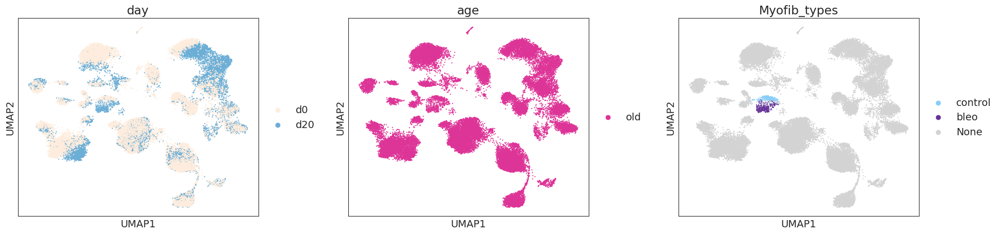

Myofibroblasts - d20
Running Myofibroblast Version
(581, 6222)


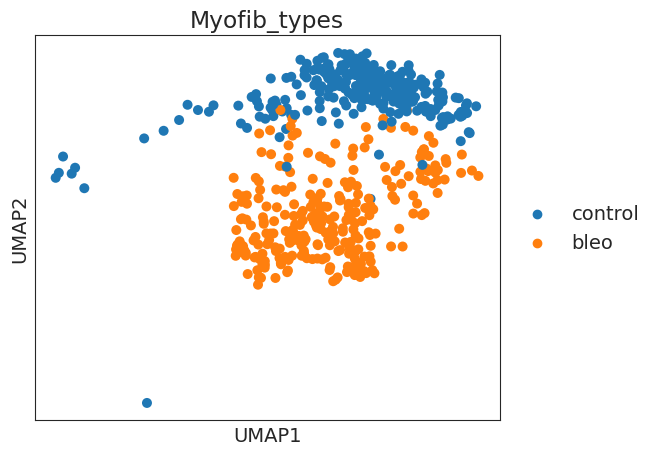

Started Diffxpy Calculation:	04-09-2024 17:51:34
training location model: True
training scale model: True
iter   0: ll=4692330.675485
caught 78 linalg singular matrix errors
iter   1: ll=4468546.928780, converged: 0.00% (loc: 4.84%, scale update: False), in 0.69sec
iter   2: ll=4403505.267845, converged: 0.00% (loc: 4.84%, scale update: False), in 0.70sec
iter   3: ll=4394176.560870, converged: 0.00% (loc: 4.84%, scale update: False), in 0.71sec
iter   4: ll=4393418.596427, converged: 0.00% (loc: 4.84%, scale update: False), in 0.90sec
iter   5: ll=4393370.191755, converged: 0.00% (loc: 4.85%, scale update: False), in 0.72sec
iter   6: ll=1800974.009133, converged: 0.00% (loc: 0.00%, scale update: True), in 6.44sec
caught 70 linalg singular matrix errors
iter   7: ll=1792947.463471, converged: 0.00% (loc: 1.30%, scale update: False), in 0.71sec
iter   8: ll=1791653.490324, converged: 0.00% (loc: 2.25%, scale update: False), in 0.71sec
iter   9: ll=1791498.591897, converged: 0.00% (loc:

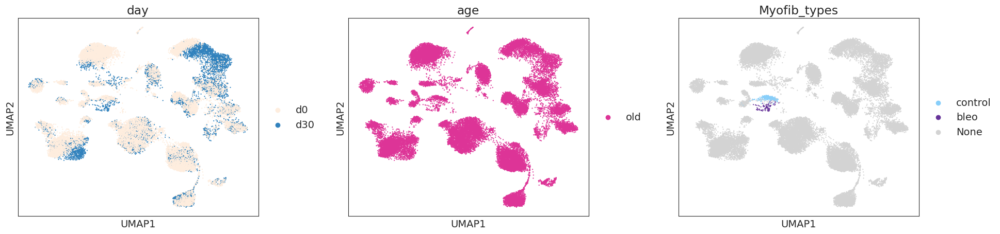

Myofibroblasts - d30
Running Myofibroblast Version
(386, 6975)


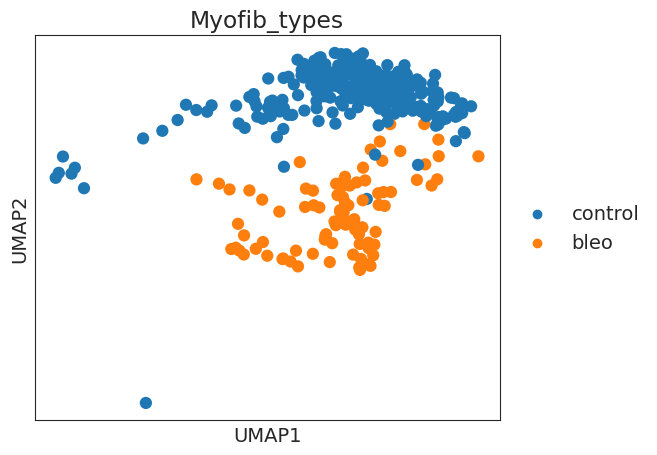

Started Diffxpy Calculation:	04-09-2024 17:52:52
training location model: True
training scale model: True
iter   0: ll=3705030.617181
caught 139 linalg singular matrix errors
iter   1: ll=3564412.406837, converged: 0.00% (loc: 8.29%, scale update: False), in 0.78sec
iter   2: ll=3519835.525867, converged: 0.00% (loc: 8.29%, scale update: False), in 0.83sec
iter   3: ll=3510161.578887, converged: 0.00% (loc: 8.29%, scale update: False), in 1.02sec
iter   4: ll=3508212.529288, converged: 0.00% (loc: 8.29%, scale update: False), in 0.78sec
iter   5: ll=3507862.026468, converged: 0.00% (loc: 8.29%, scale update: False), in 0.84sec
iter   6: ll=1249017.948342, converged: 0.00% (loc: 0.00%, scale update: True), in 5.92sec
caught 123 linalg singular matrix errors
iter   7: ll=1244844.024433, converged: 0.00% (loc: 2.32%, scale update: False), in 0.80sec
iter   8: ll=1243859.383833, converged: 0.00% (loc: 2.61%, scale update: False), in 0.98sec
iter   9: ll=1243646.896889, converged: 0.00% (lo

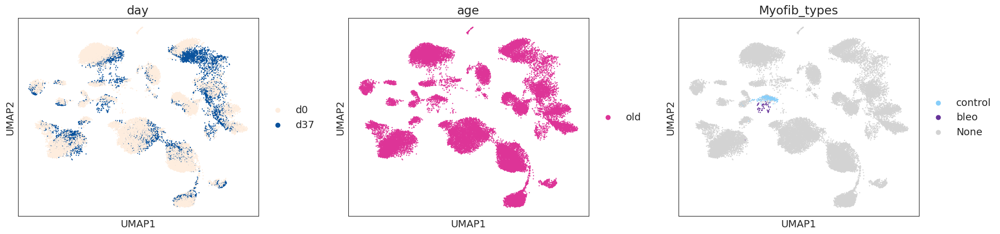

Myofibroblasts - d37
Running Myofibroblast Version
(350, 6440)


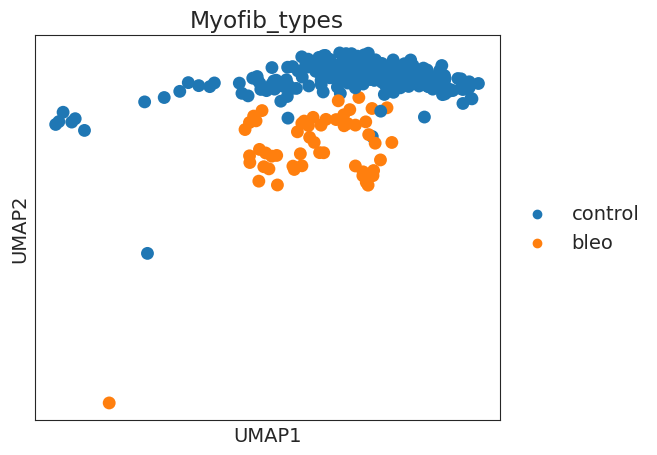

Started Diffxpy Calculation:	04-09-2024 17:54:41
training location model: True
training scale model: True
iter   0: ll=2051587.391053
caught 184 linalg singular matrix errors
iter   1: ll=1950193.702658, converged: 0.00% (loc: 6.63%, scale update: False), in 0.95sec
iter   2: ll=1923708.850316, converged: 0.00% (loc: 6.63%, scale update: False), in 0.81sec
iter   3: ll=1920034.798457, converged: 0.00% (loc: 6.63%, scale update: False), in 0.80sec
iter   4: ll=1919490.673636, converged: 0.00% (loc: 6.63%, scale update: False), in 0.81sec
iter   5: ll=1919391.859089, converged: 0.00% (loc: 6.69%, scale update: False), in 0.81sec
iter   6: ll=977715.782977, converged: 0.00% (loc: 0.00%, scale update: True), in 5.62sec
caught 172 linalg singular matrix errors
iter   7: ll=975138.280681, converged: 0.00% (loc: 3.25%, scale update: False), in 0.81sec
iter   8: ll=974509.409255, converged: 0.00% (loc: 3.66%, scale update: False), in 0.80sec
iter   9: ll=974364.230852, converged: 0.00% (loc: 5

In [34]:
condition = "Myofib_types"
ct = "Myofibroblasts"
id1 = "control"
id2 = "bleo"
subset = [id1, id2]
age = "old"
ct_label = "Myofib_types"

for time in ["d3", "d10", "d20", "d30", "d37"]:
    time_subset = adata[(adata.obs.age == age) & (adata.obs.day.isin([time, "d0"]))].copy()
    sc.pl.umap(time_subset, color = ["day", "age", ct_label], size = 10, wspace = 0.25)
        
    ## Actually run the function
    print("%s - %s" %(ct, time))
    dge(time_subset, ct = ct, ct_label = ct_label, condition = condition, ref = subset[0],
        pct_thresh = 0.05, subset = subset, min_cells = 10, suffix = "_%s" %age, myofib = True)

#### activated AT2

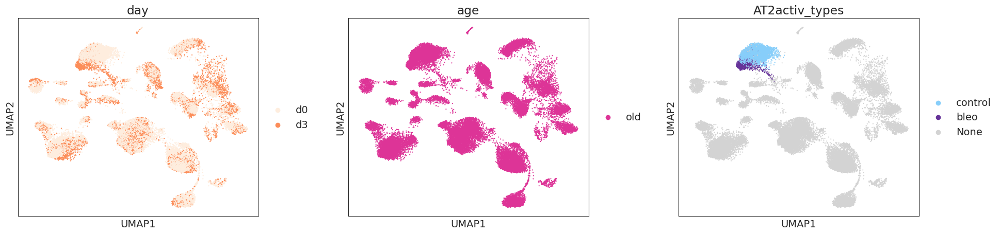

AT2 activated - d3
Running Myofibroblast Version
(4905, 4571)


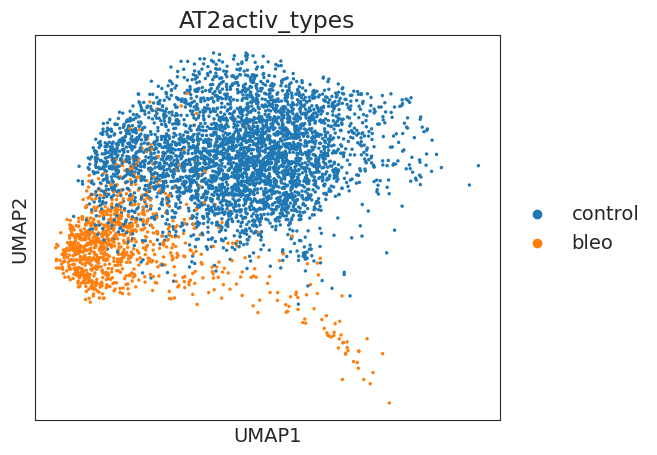

Started Diffxpy Calculation:	04-09-2024 17:56:20
training location model: True
training scale model: True
iter   0: ll=12791379.213046
iter   1: ll=11292663.265826, converged: 0.00% (loc: 0.66%, scale update: False), in 1.86sec
iter   2: ll=10955879.996805, converged: 0.00% (loc: 0.66%, scale update: False), in 1.73sec
iter   3: ll=10930788.032169, converged: 0.00% (loc: 0.66%, scale update: False), in 1.77sec
iter   4: ll=10930282.005630, converged: 0.00% (loc: 0.66%, scale update: False), in 1.78sec
iter   5: ll=10930275.930497, converged: 0.00% (loc: 0.83%, scale update: False), in 1.98sec
iter   6: ll=9564005.640342, converged: 0.00% (loc: 0.00%, scale update: True), in 22.08sec
iter   7: ll=9561788.922227, converged: 0.00% (loc: 0.11%, scale update: False), in 1.84sec
iter   8: ll=9561511.865477, converged: 0.00% (loc: 2.08%, scale update: False), in 1.76sec
iter   9: ll=9561501.558904, converged: 0.00% (loc: 19.84%, scale update: False), in 1.80sec
iter  10: ll=9561501.470186, co

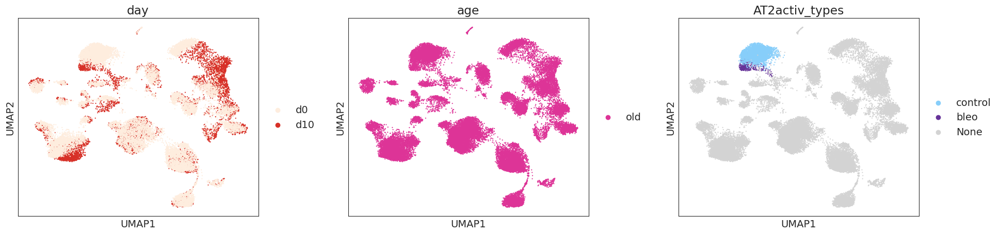

AT2 activated - d10
Running Myofibroblast Version
(4273, 5164)


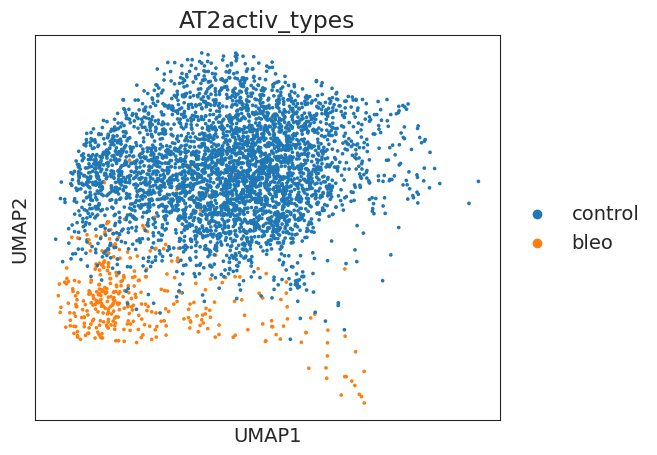

Started Diffxpy Calculation:	04-09-2024 17:58:29
training location model: True
training scale model: True
iter   0: ll=13070401.600694
iter   1: ll=11763464.509302, converged: 0.00% (loc: 1.84%, scale update: False), in 1.82sec
iter   2: ll=11467525.788814, converged: 0.00% (loc: 1.84%, scale update: False), in 1.91sec
iter   3: ll=11443068.525036, converged: 0.00% (loc: 1.84%, scale update: False), in 1.70sec
iter   4: ll=11442085.326524, converged: 0.00% (loc: 1.84%, scale update: False), in 1.90sec
iter   5: ll=11442040.713054, converged: 0.00% (loc: 1.86%, scale update: False), in 1.73sec
iter   6: ll=8543845.546112, converged: 0.00% (loc: 0.00%, scale update: True), in 21.67sec
iter   7: ll=8539317.611081, converged: 0.00% (loc: 0.12%, scale update: False), in 1.80sec
iter   8: ll=8538635.825767, converged: 0.00% (loc: 0.79%, scale update: False), in 1.78sec
iter   9: ll=8538596.427097, converged: 0.00% (loc: 6.95%, scale update: False), in 1.82sec
iter  10: ll=8538588.456370, con

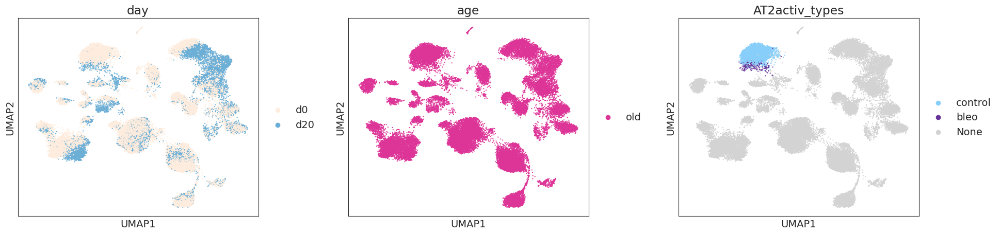

AT2 activated - d20
Running Myofibroblast Version
(4187, 4352)


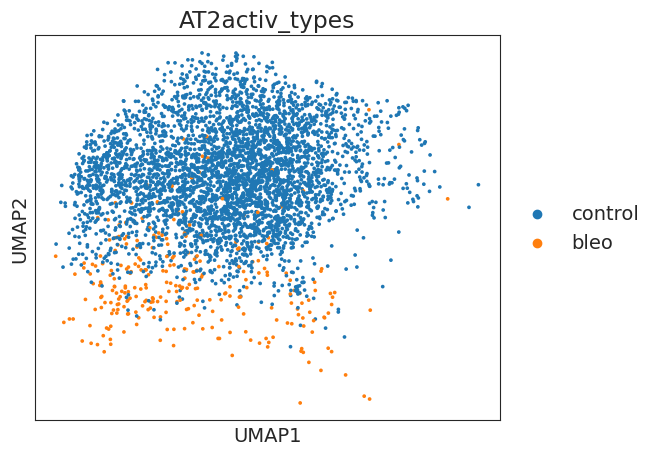

Started Diffxpy Calculation:	04-09-2024 18:00:52
training location model: True
training scale model: True
iter   0: ll=9373725.431256
iter   1: ll=8254492.270842, converged: 0.00% (loc: 0.30%, scale update: False), in 1.66sec
iter   2: ll=8018757.485310, converged: 0.00% (loc: 0.30%, scale update: False), in 1.55sec
iter   3: ll=8004543.249401, converged: 0.00% (loc: 0.30%, scale update: False), in 1.82sec
iter   4: ll=8004384.834553, converged: 0.00% (loc: 0.30%, scale update: False), in 1.62sec
iter   5: ll=8004383.621218, converged: 0.00% (loc: 1.08%, scale update: False), in 1.47sec
iter   6: ll=7582519.783903, converged: 0.00% (loc: 0.00%, scale update: True), in 18.45sec
iter   7: ll=7581842.976958, converged: 0.00% (loc: 0.02%, scale update: False), in 1.62sec
iter   8: ll=7581808.644283, converged: 0.00% (loc: 2.53%, scale update: False), in 1.55sec
iter   9: ll=7581808.105613, converged: 0.00% (loc: 23.25%, scale update: False), in 1.42sec
iter  10: ll=7581808.103973, converge

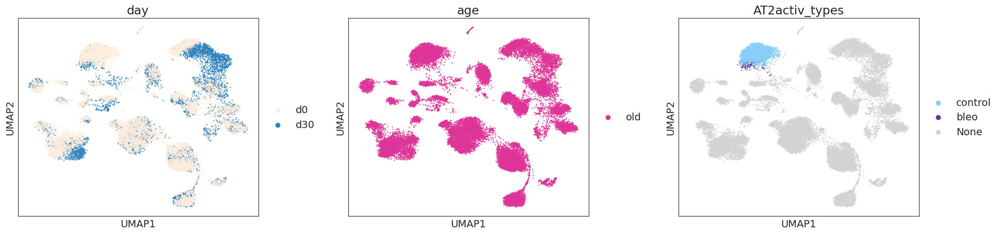

AT2 activated - d30
Running Myofibroblast Version
(4107, 4603)


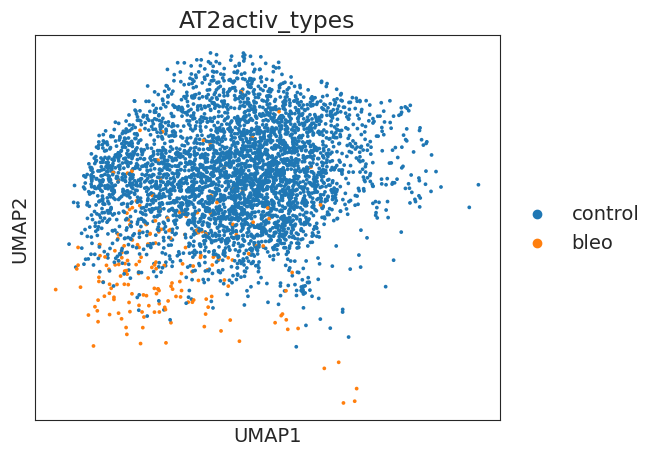

Started Diffxpy Calculation:	04-09-2024 18:02:38
training location model: True
training scale model: True
iter   0: ll=9776890.266354
iter   1: ll=8647686.737940, converged: 0.00% (loc: 0.63%, scale update: False), in 1.59sec
iter   2: ll=8404297.578827, converged: 0.00% (loc: 0.63%, scale update: False), in 1.53sec
iter   3: ll=8387461.693891, converged: 0.00% (loc: 0.63%, scale update: False), in 1.58sec
iter   4: ll=8386936.620945, converged: 0.00% (loc: 0.63%, scale update: False), in 1.53sec
iter   5: ll=8386903.574672, converged: 0.00% (loc: 0.85%, scale update: False), in 1.61sec
iter   6: ll=7601898.545807, converged: 0.00% (loc: 0.00%, scale update: True), in 18.80sec
iter   7: ll=7599852.074109, converged: 0.00% (loc: 0.04%, scale update: False), in 1.68sec
iter   8: ll=7599446.935499, converged: 0.00% (loc: 0.85%, scale update: False), in 1.56sec
iter   9: ll=7599379.068624, converged: 0.00% (loc: 6.41%, scale update: False), in 1.67sec
iter  10: ll=7599371.570371, converged

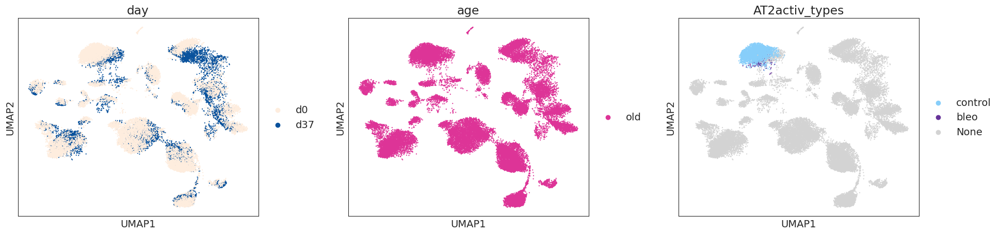

AT2 activated - d37
Running Myofibroblast Version
(4041, 4768)


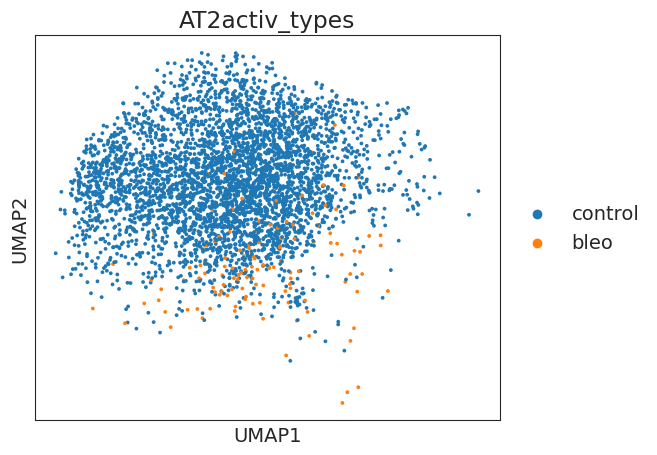

Started Diffxpy Calculation:	04-09-2024 18:04:41
training location model: True
training scale model: True
iter   0: ll=9859748.589833
caught 1 linalg singular matrix errors
iter   1: ll=8729006.944541, converged: 0.00% (loc: 0.82%, scale update: False), in 1.59sec
iter   2: ll=8482546.859615, converged: 0.00% (loc: 0.82%, scale update: False), in 1.84sec
iter   3: ll=8464270.810695, converged: 0.00% (loc: 0.82%, scale update: False), in 1.60sec
iter   4: ll=8463478.646347, converged: 0.00% (loc: 0.82%, scale update: False), in 1.68sec
iter   5: ll=8463417.251029, converged: 0.00% (loc: 0.82%, scale update: False), in 1.60sec
iter   6: ll=7566601.082928, converged: 0.00% (loc: 0.00%, scale update: True), in 19.25sec
caught 1 linalg singular matrix errors
iter   7: ll=7564858.615486, converged: 0.00% (loc: 0.06%, scale update: False), in 1.63sec
iter   8: ll=7564670.958322, converged: 0.00% (loc: 0.59%, scale update: False), in 1.64sec
iter   9: ll=7564658.369356, converged: 0.00% (loc: 

In [35]:
condition = "AT2activ_types"
ct = "AT2 activated"

id1 = "control"
id2 = "bleo"
subset = [id1, id2]
age = "old"
ct_label = "AT2activ_types"

for time in ["d3", "d10", "d20", "d30", "d37"]:
    time_subset = adata[(adata.obs.age == age) & (adata.obs.day.isin([time, "d0"]))].copy()
    sc.pl.umap(time_subset, color = ["day", "age", ct_label], size = 10, wspace = 0.25)

    ## Actually run the function
    print("%s - %s" %(ct, time))
    dge(time_subset, ct = ct, ct_label = ct_label, condition = condition, ref = subset[0], 
        pct_thresh = 0.05, subset = subset, min_cells = 10, suffix = "_%s" %age, myofib = True)

#### Krt8 ADI

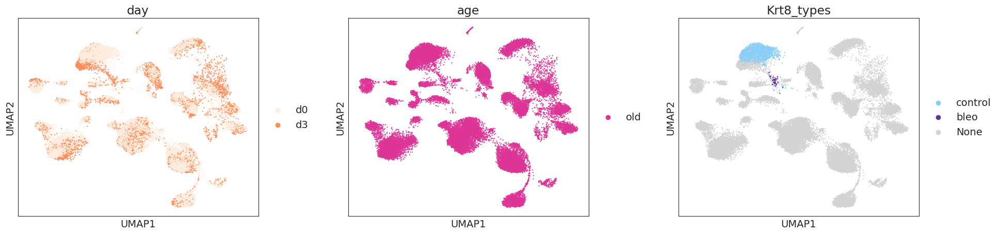

Krt8-ADI - d3
Running Myofibroblast Version
(3703, 4768)


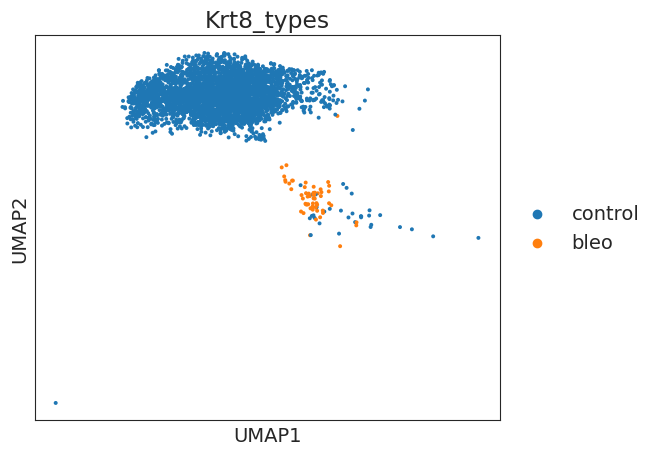

Started Diffxpy Calculation:	04-09-2024 18:06:44
training location model: True
training scale model: True
iter   0: ll=8183171.875132
caught 62 linalg singular matrix errors
iter   1: ll=7298862.146445, converged: 0.00% (loc: 2.29%, scale update: False), in 1.55sec
iter   2: ll=7116405.949481, converged: 0.00% (loc: 2.29%, scale update: False), in 1.38sec
iter   3: ll=7106352.440538, converged: 0.00% (loc: 2.29%, scale update: False), in 1.48sec
iter   4: ll=7106269.702698, converged: 0.00% (loc: 2.29%, scale update: False), in 1.67sec
iter   5: ll=7106269.031174, converged: 0.00% (loc: 5.08%, scale update: False), in 1.54sec
iter   6: ll=6556551.931812, converged: 0.00% (loc: 0.00%, scale update: True), in 17.97sec
caught 62 linalg singular matrix errors
iter   7: ll=6555708.275523, converged: 0.00% (loc: 1.55%, scale update: False), in 1.57sec
iter   8: ll=6555641.477247, converged: 0.00% (loc: 4.19%, scale update: False), in 1.54sec
iter   9: ll=6555639.474057, converged: 0.00% (loc

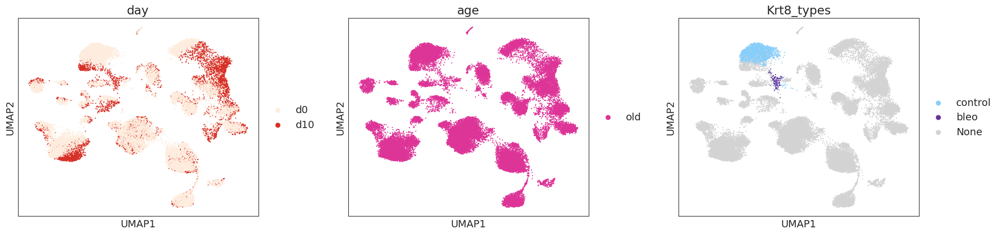

Krt8-ADI - d10
Running Myofibroblast Version
(3761, 5839)


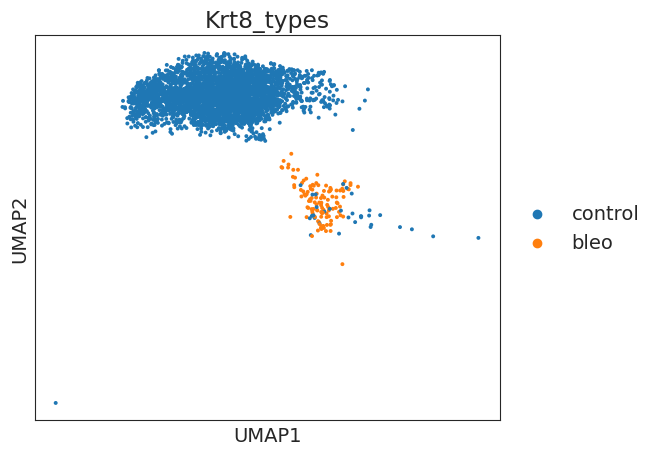

Started Diffxpy Calculation:	04-09-2024 18:08:31
training location model: True
training scale model: True
iter   0: ll=9189588.915134
caught 49 linalg singular matrix errors
iter   1: ll=8251924.153054, converged: 0.00% (loc: 1.90%, scale update: False), in 1.80sec
iter   2: ll=8056160.501643, converged: 0.00% (loc: 1.90%, scale update: False), in 1.91sec
iter   3: ll=8044551.796631, converged: 0.00% (loc: 1.90%, scale update: False), in 1.78sec
iter   4: ll=8044352.290544, converged: 0.00% (loc: 1.90%, scale update: False), in 1.86sec
iter   5: ll=8044342.006334, converged: 0.00% (loc: 3.19%, scale update: False), in 1.82sec
iter   6: ll=7220566.463020, converged: 0.00% (loc: 0.00%, scale update: True), in 21.53sec
caught 48 linalg singular matrix errors
iter   7: ll=7218663.090372, converged: 0.00% (loc: 0.92%, scale update: False), in 1.97sec
iter   8: ll=7218500.246580, converged: 0.00% (loc: 1.64%, scale update: False), in 1.83sec
iter   9: ll=7218486.924370, converged: 0.00% (loc

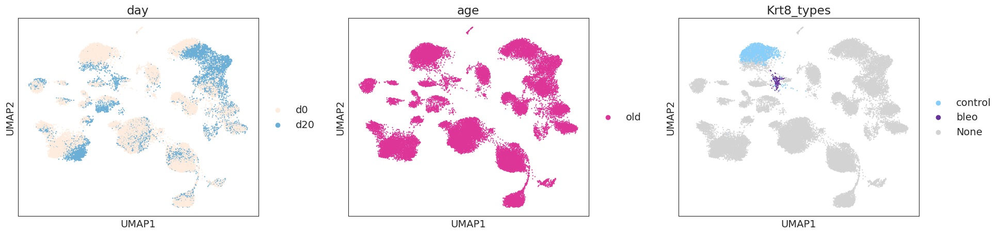

Krt8-ADI - d20
Running Myofibroblast Version
(3766, 5271)


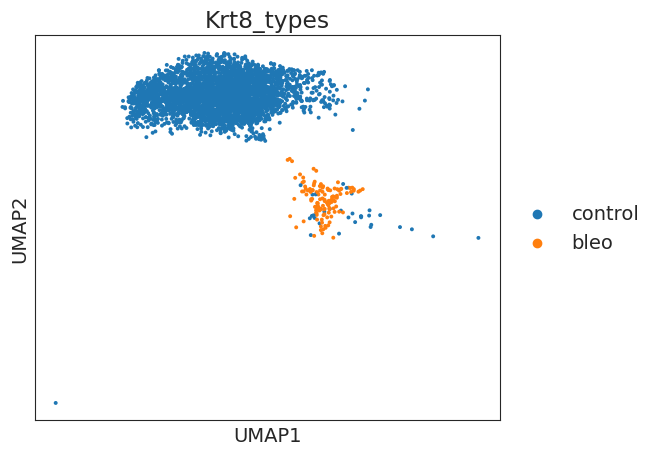

Started Diffxpy Calculation:	04-09-2024 18:11:01
training location model: True
training scale model: True
iter   0: ll=8703824.383485
caught 46 linalg singular matrix errors
iter   1: ll=7791316.832520, converged: 0.00% (loc: 1.69%, scale update: False), in 1.69sec
iter   2: ll=7601637.850834, converged: 0.00% (loc: 1.69%, scale update: False), in 1.71sec
iter   3: ll=7590712.526269, converged: 0.00% (loc: 1.69%, scale update: False), in 1.81sec
iter   4: ll=7590581.327556, converged: 0.00% (loc: 1.69%, scale update: False), in 1.68sec
iter   5: ll=7590578.342849, converged: 0.00% (loc: 3.17%, scale update: False), in 1.65sec
iter   6: ll=6984854.979209, converged: 0.00% (loc: 0.00%, scale update: True), in 19.85sec
caught 46 linalg singular matrix errors
iter   7: ll=6983391.094414, converged: 0.00% (loc: 0.91%, scale update: False), in 1.76sec
iter   8: ll=6983234.809865, converged: 0.00% (loc: 2.07%, scale update: False), in 1.77sec
iter   9: ll=6983202.806420, converged: 0.00% (loc

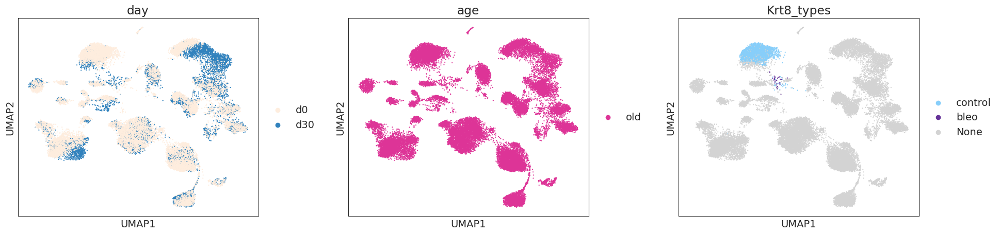

Krt8-ADI - d30
Running Myofibroblast Version
(3673, 5777)


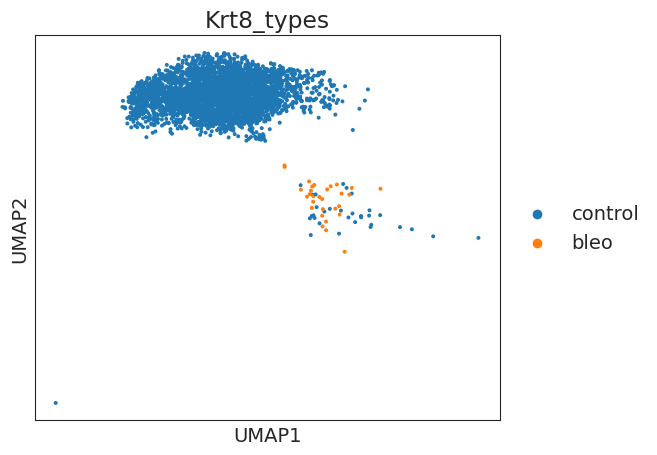

Started Diffxpy Calculation:	04-09-2024 18:13:03
training location model: True
training scale model: True
iter   0: ll=9258115.593000
caught 126 linalg singular matrix errors
iter   1: ll=8342236.256097, converged: 0.00% (loc: 4.45%, scale update: False), in 1.82sec
iter   2: ll=8152227.610518, converged: 0.00% (loc: 4.45%, scale update: False), in 1.73sec
iter   3: ll=8141117.840107, converged: 0.00% (loc: 4.45%, scale update: False), in 1.75sec
iter   4: ll=8140863.006487, converged: 0.00% (loc: 4.45%, scale update: False), in 1.75sec
iter   5: ll=8140828.133051, converged: 0.00% (loc: 5.66%, scale update: False), in 1.86sec
iter   6: ll=6920863.661408, converged: 0.00% (loc: 0.00%, scale update: True), in 21.04sec
caught 125 linalg singular matrix errors
iter   7: ll=6917986.933022, converged: 0.00% (loc: 2.32%, scale update: False), in 1.88sec
iter   8: ll=6917492.073479, converged: 0.00% (loc: 3.27%, scale update: False), in 1.76sec
iter   9: ll=6917391.291836, converged: 0.00% (l

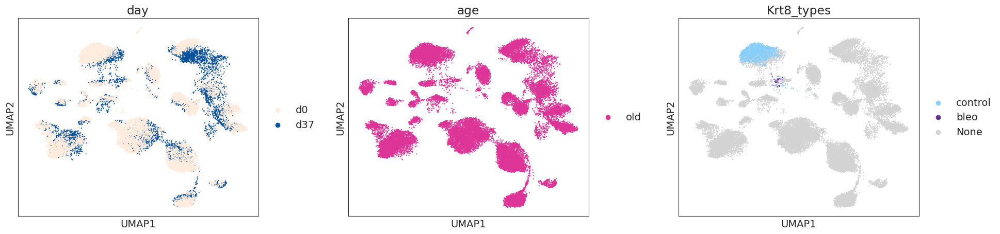

Krt8-ADI - d37
Running Myofibroblast Version
(3685, 5448)


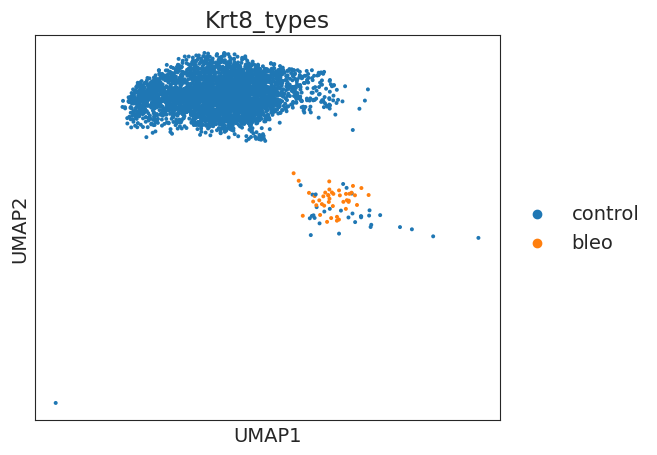

Started Diffxpy Calculation:	04-09-2024 18:15:30
training location model: True
training scale model: True
iter   0: ll=9334539.704920
caught 82 linalg singular matrix errors
iter   1: ll=8418358.241331, converged: 0.00% (loc: 3.80%, scale update: False), in 1.74sec
iter   2: ll=8226606.514957, converged: 0.00% (loc: 3.80%, scale update: False), in 1.80sec
iter   3: ll=8214700.527140, converged: 0.00% (loc: 3.80%, scale update: False), in 1.63sec
iter   4: ll=8214335.405188, converged: 0.00% (loc: 3.80%, scale update: False), in 1.69sec
iter   5: ll=8214290.955595, converged: 0.00% (loc: 4.19%, scale update: False), in 1.58sec
iter   6: ll=6868856.078038, converged: 0.00% (loc: 0.00%, scale update: True), in 20.05sec
caught 82 linalg singular matrix errors
iter   7: ll=6865527.098449, converged: 0.00% (loc: 1.56%, scale update: False), in 1.68sec
iter   8: ll=6864994.190427, converged: 0.00% (loc: 2.51%, scale update: False), in 1.61sec
iter   9: ll=6864913.611240, converged: 0.00% (loc

In [36]:
condition = "Krt8_types"
ct = "Krt8-ADI"

id1 = "control"
id2 = "bleo"
subset = [id1, id2]
age = "old"
ct_label = "Krt8_types"

for time in ["d3", "d10", "d20", "d30", "d37"]:
    time_subset = adata[(adata.obs.age == age) & (adata.obs.day.isin([time, "d0"]))].copy()
    sc.pl.umap(time_subset, color = ["day", "age", ct_label], size = 10, wspace = 0.25)

    ## Actually run the function
    print("%s - %s" %(ct, time))
    dge(time_subset, ct = ct, ct_label = ct_label, condition = condition, ref = subset[0], 
        pct_thresh = 0.05, subset = subset, min_cells = 10, suffix = "_%s" %age, myofib = True)

#### AT2

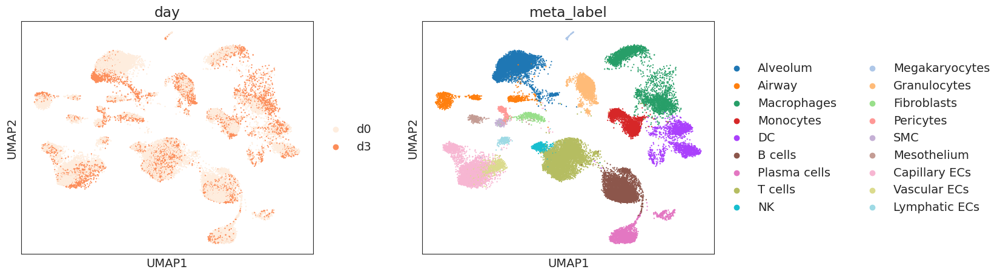

AT2 - d3
(3772, 3703)


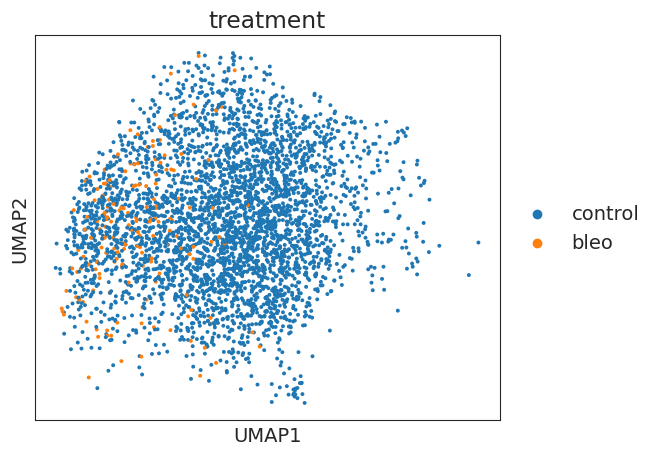

Started Diffxpy Calculation:	04-09-2024 18:17:44
training location model: True
training scale model: True
iter   0: ll=7494789.933779
iter   1: ll=6549317.937485, converged: 0.00% (loc: 0.05%, scale update: False), in 1.32sec
iter   2: ll=6353999.697716, converged: 0.00% (loc: 0.05%, scale update: False), in 1.33sec
iter   3: ll=6343147.701855, converged: 0.00% (loc: 0.05%, scale update: False), in 1.30sec
iter   4: ll=6343061.684392, converged: 0.00% (loc: 0.05%, scale update: False), in 1.28sec
iter   5: ll=6343061.434089, converged: 0.00% (loc: 1.16%, scale update: False), in 1.32sec
iter   6: ll=6273857.939080, converged: 0.00% (loc: 0.00%, scale update: True), in 14.69sec
iter   7: ll=6273621.211825, converged: 0.00% (loc: 0.14%, scale update: False), in 1.32sec
iter   8: ll=6273615.740105, converged: 0.00% (loc: 3.65%, scale update: False), in 1.32sec
iter   9: ll=6273615.584735, converged: 0.00% (loc: 38.27%, scale update: False), in 1.44sec
iter  10: ll=6273615.584289, converge

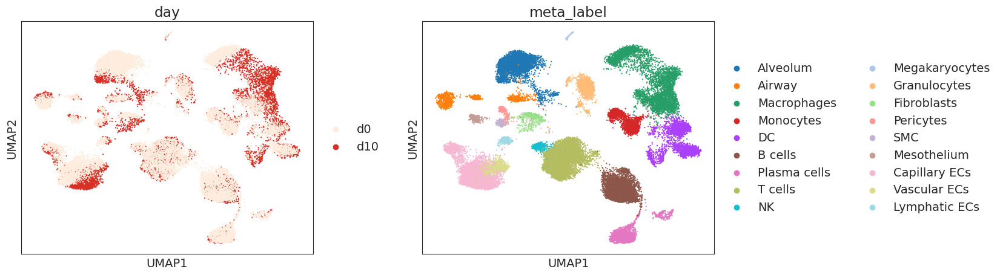

AT2 - d10
(3647, 3730)


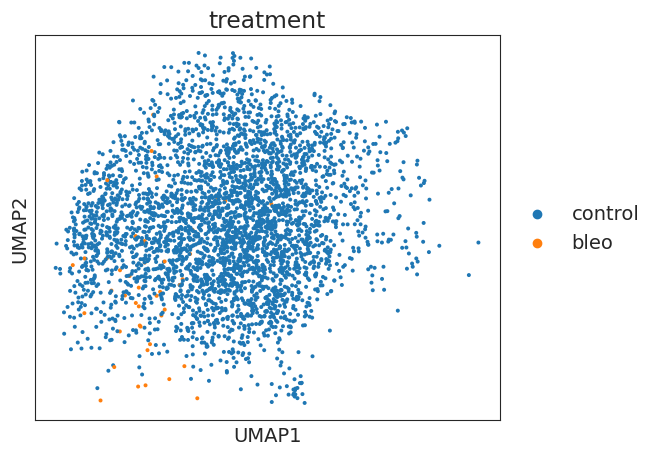

Started Diffxpy Calculation:	04-09-2024 18:19:06
training location model: True
training scale model: True
iter   0: ll=7282553.299238
caught 77 linalg singular matrix errors
iter   1: ll=6378176.260282, converged: 0.00% (loc: 2.33%, scale update: False), in 1.38sec
iter   2: ll=6192173.411357, converged: 0.00% (loc: 2.33%, scale update: False), in 1.28sec
iter   3: ll=6181929.277660, converged: 0.00% (loc: 2.33%, scale update: False), in 1.31sec
iter   4: ll=6181850.235911, converged: 0.00% (loc: 2.33%, scale update: False), in 1.18sec
iter   5: ll=6181849.994689, converged: 0.00% (loc: 3.24%, scale update: False), in 1.30sec
iter   6: ll=6023119.133358, converged: 0.00% (loc: 0.00%, scale update: True), in 14.38sec
caught 77 linalg singular matrix errors
iter   7: ll=6022810.048264, converged: 0.00% (loc: 2.20%, scale update: False), in 1.35sec
iter   8: ll=6022790.542410, converged: 0.00% (loc: 5.90%, scale update: False), in 1.29sec
iter   9: ll=6022790.015207, converged: 0.00% (loc

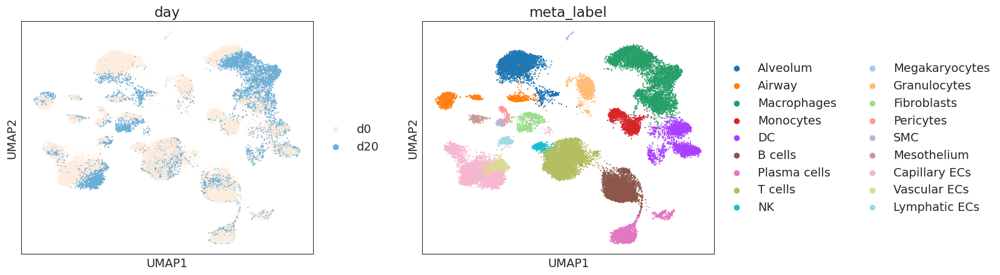

AT2 - d20
(3663, 3190)


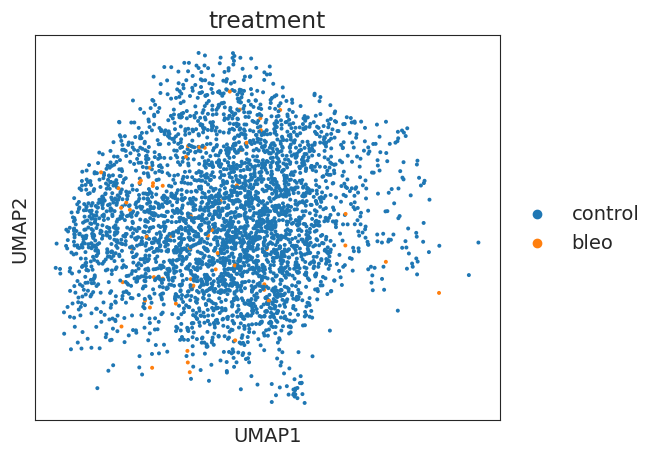

Started Diffxpy Calculation:	04-09-2024 18:20:30
training location model: True
training scale model: True
iter   0: ll=6823865.305478
caught 83 linalg singular matrix errors
iter   1: ll=5954255.600671, converged: 0.00% (loc: 2.60%, scale update: False), in 1.25sec
iter   2: ll=5775165.855967, converged: 0.00% (loc: 2.60%, scale update: False), in 1.11sec
iter   3: ll=5765378.779013, converged: 0.00% (loc: 2.60%, scale update: False), in 1.17sec
iter   4: ll=5765306.948437, converged: 0.00% (loc: 2.60%, scale update: False), in 1.23sec
iter   5: ll=5765306.803438, converged: 0.00% (loc: 3.39%, scale update: False), in 1.17sec
iter   6: ll=5744037.340640, converged: 0.00% (loc: 0.00%, scale update: True), in 12.62sec
caught 83 linalg singular matrix errors
iter   7: ll=5743884.765207, converged: 0.00% (loc: 2.73%, scale update: False), in 1.14sec
iter   8: ll=5743884.104209, converged: 0.00% (loc: 6.52%, scale update: False), in 1.12sec
iter   9: ll=5743884.101825, converged: 0.00% (loc

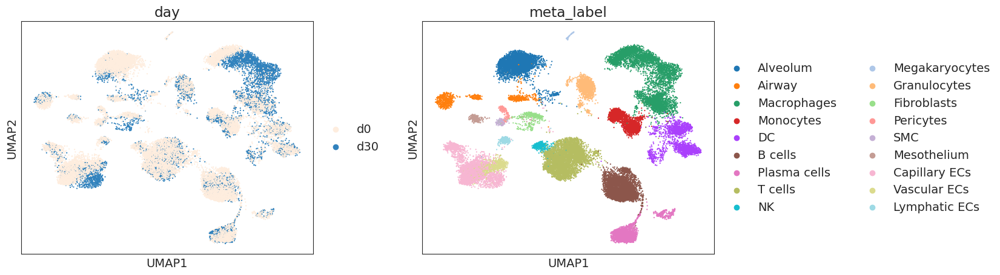

AT2 - d30
(3670, 3728)


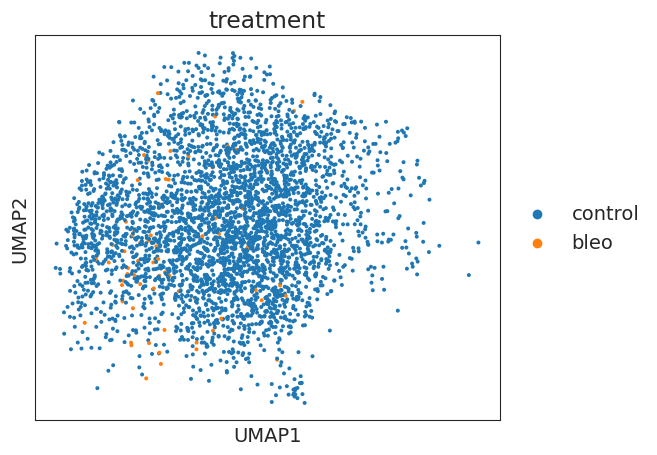

Started Diffxpy Calculation:	04-09-2024 18:21:41
training location model: True
training scale model: True
iter   0: ll=7326853.848846
caught 22 linalg singular matrix errors
iter   1: ll=6407613.155631, converged: 0.00% (loc: 0.78%, scale update: False), in 1.23sec
iter   2: ll=6218227.993804, converged: 0.00% (loc: 0.78%, scale update: False), in 1.44sec
iter   3: ll=6207724.552896, converged: 0.00% (loc: 0.78%, scale update: False), in 1.26sec
iter   4: ll=6207638.707059, converged: 0.00% (loc: 0.78%, scale update: False), in 1.27sec
iter   5: ll=6207638.283947, converged: 0.00% (loc: 1.69%, scale update: False), in 1.38sec
iter   6: ll=6080248.958747, converged: 0.00% (loc: 0.00%, scale update: True), in 14.41sec
caught 22 linalg singular matrix errors
iter   7: ll=6079992.989309, converged: 0.00% (loc: 0.67%, scale update: False), in 1.33sec
iter   8: ll=6079982.610732, converged: 0.00% (loc: 3.65%, scale update: False), in 1.35sec
iter   9: ll=6079982.367225, converged: 0.00% (loc

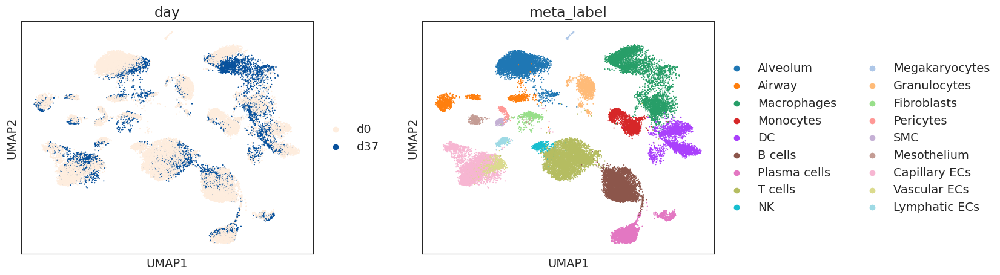

AT2 - d37
(3954, 3403)


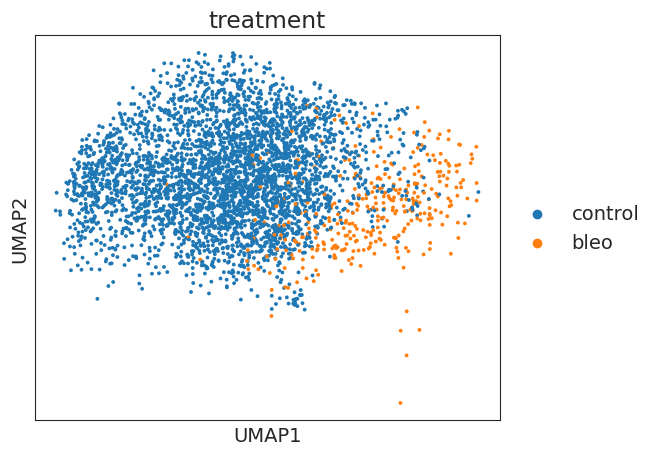

Started Diffxpy Calculation:	04-09-2024 18:23:11
training location model: True
training scale model: True
iter   0: ll=7593745.053964
caught 1 linalg singular matrix errors
iter   1: ll=6630720.922916, converged: 0.00% (loc: 0.03%, scale update: False), in 1.27sec
iter   2: ll=6428972.730203, converged: 0.00% (loc: 0.03%, scale update: False), in 1.34sec
iter   3: ll=6417108.975260, converged: 0.00% (loc: 0.03%, scale update: False), in 1.29sec
iter   4: ll=6416978.784892, converged: 0.00% (loc: 0.03%, scale update: False), in 1.25sec
iter   5: ll=6416977.591159, converged: 0.00% (loc: 0.29%, scale update: False), in 1.28sec
iter   6: ll=6397959.925677, converged: 0.00% (loc: 0.00%, scale update: True), in 14.06sec
caught 1 linalg singular matrix errors
iter   7: ll=6397770.667801, converged: 0.00% (loc: 0.09%, scale update: False), in 1.28sec
iter   8: ll=6397768.555511, converged: 0.00% (loc: 2.70%, scale update: False), in 1.37sec
iter   9: ll=6397768.515038, converged: 0.00% (loc: 

In [37]:
subset = ["control", "bleo"]
condition = "treatment"
ct_label = "cell_type"
min_cells = 10
age = "old"
cell_types = ["AT2"]
for time in ["d3", "d10", "d20", "d30", "d37"]:
    time_subset = adata[(adata.obs.age == age) & (adata.obs.day.isin([time, "d0"]))].copy()
    for ct in cell_types:
        sc.pl.umap(time_subset, color = ["day", "meta_label"], size = 10, wspace = 0.25)
        print("%s - %s" %(ct, time))
        dge(time_subset, ct = ct, ct_label = ct_label, condition = condition, ref = "control", pct_thresh = 0.05,
              subset = subset, min_cells = min_cells, do_return = False, suffix = "_old")

#### AT1

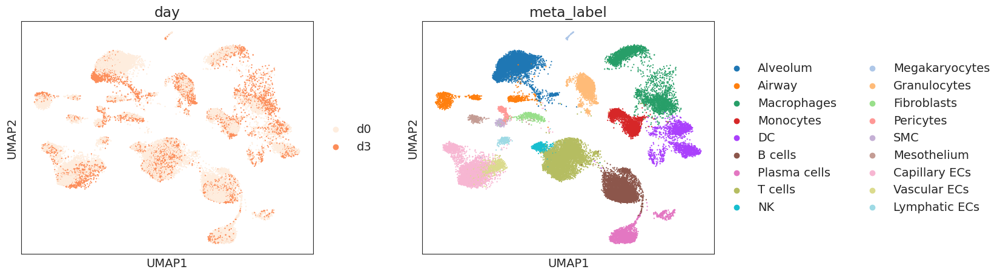

AT1 - d3
(104, 5042)


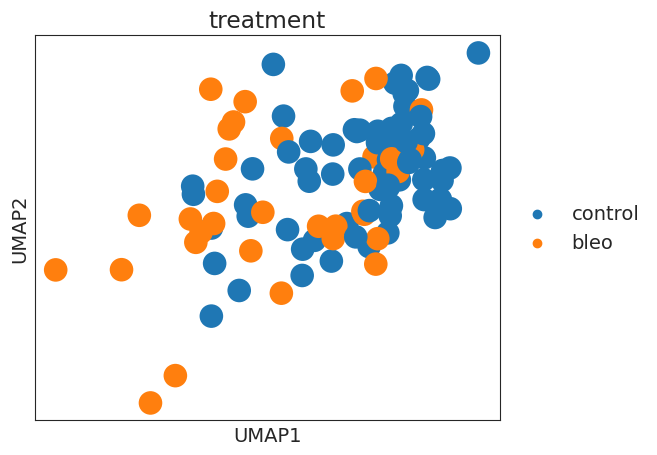

Started Diffxpy Calculation:	04-09-2024 18:24:31
training location model: True
training scale model: True
iter   0: ll=2562241.222947
caught 143 linalg singular matrix errors
iter   1: ll=2525878.444351, converged: 0.00% (loc: 18.03%, scale update: False), in 0.76sec
iter   2: ll=2515238.596492, converged: 0.00% (loc: 18.03%, scale update: False), in 0.60sec
iter   3: ll=2513738.759914, converged: 0.00% (loc: 18.03%, scale update: False), in 0.60sec
iter   4: ll=2513627.483357, converged: 0.00% (loc: 18.03%, scale update: False), in 0.63sec
iter   5: ll=2513620.671108, converged: 0.00% (loc: 18.09%, scale update: False), in 0.60sec
iter   6: ll=352512.636399, converged: 0.00% (loc: 0.00%, scale update: True), in 3.49sec
caught 142 linalg singular matrix errors
iter   7: ll=347877.518824, converged: 0.00% (loc: 4.76%, scale update: False), in 0.64sec
iter   8: ll=347073.530291, converged: 0.00% (loc: 5.67%, scale update: False), in 0.63sec
iter   9: ll=347008.713204, converged: 0.00% (l

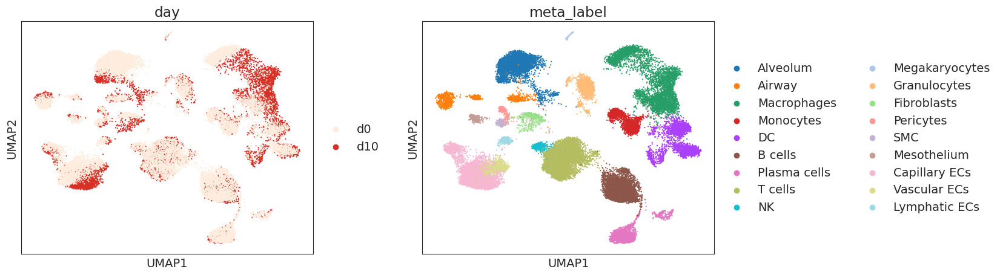

AT1 - d10
(96, 4722)


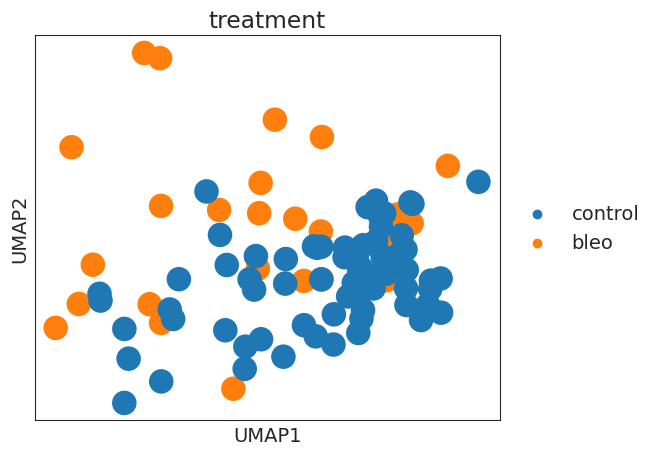

Started Diffxpy Calculation:	04-09-2024 18:25:40
training location model: True
training scale model: True
iter   0: ll=2427041.420824
caught 279 linalg singular matrix errors
iter   1: ll=2390116.996035, converged: 0.00% (loc: 20.39%, scale update: False), in 0.48sec
iter   2: ll=2379620.703081, converged: 0.00% (loc: 20.39%, scale update: False), in 0.54sec
iter   3: ll=2378169.298484, converged: 0.00% (loc: 20.39%, scale update: False), in 0.56sec
iter   4: ll=2378060.768504, converged: 0.00% (loc: 20.39%, scale update: False), in 0.55sec
iter   5: ll=2378054.324193, converged: 0.00% (loc: 20.52%, scale update: False), in 0.56sec
iter   6: ll=335597.273653, converged: 0.00% (loc: 0.00%, scale update: True), in 3.30sec
caught 275 linalg singular matrix errors
iter   7: ll=330749.898166, converged: 0.00% (loc: 7.29%, scale update: False), in 0.58sec
iter   8: ll=329836.538244, converged: 0.00% (loc: 8.51%, scale update: False), in 0.76sec
iter   9: ll=329727.394073, converged: 0.00% (l

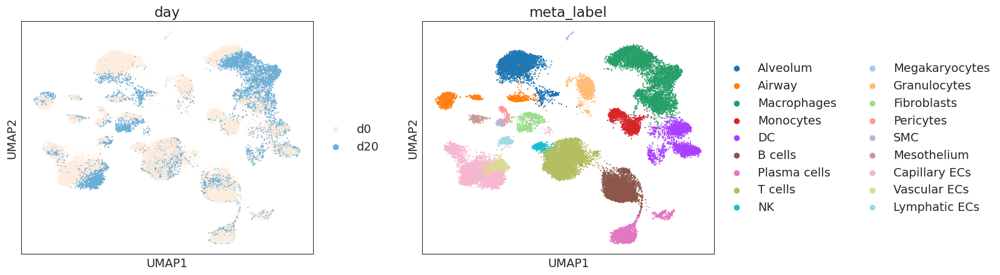

AT1 - d20
(114, 4843)


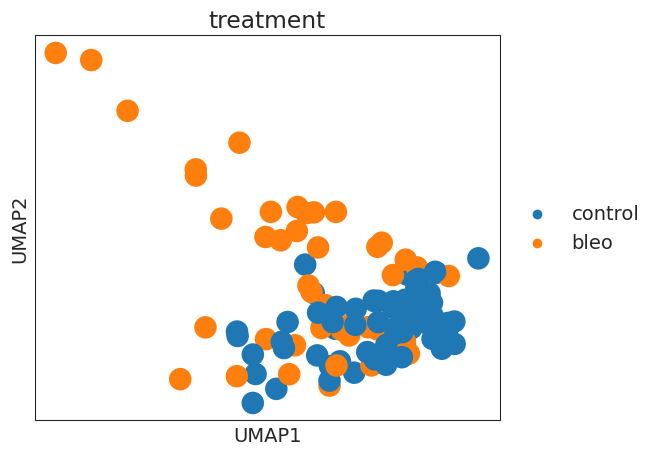

Started Diffxpy Calculation:	04-09-2024 18:26:44
training location model: True
training scale model: True
iter   0: ll=1742584.157401
caught 187 linalg singular matrix errors
iter   1: ll=1705262.326408, converged: 0.00% (loc: 14.08%, scale update: False), in 0.51sec
iter   2: ll=1695126.480308, converged: 0.00% (loc: 14.08%, scale update: False), in 0.55sec
iter   3: ll=1693905.318578, converged: 0.00% (loc: 14.08%, scale update: False), in 0.53sec
iter   4: ll=1693832.120068, converged: 0.00% (loc: 14.08%, scale update: False), in 0.64sec
iter   5: ll=1693828.320008, converged: 0.00% (loc: 14.29%, scale update: False), in 0.52sec
iter   6: ll=336115.664095, converged: 0.00% (loc: 0.00%, scale update: True), in 3.32sec
caught 187 linalg singular matrix errors
iter   7: ll=332813.744898, converged: 0.00% (loc: 5.10%, scale update: False), in 0.57sec
iter   8: ll=332169.666613, converged: 0.00% (loc: 6.24%, scale update: False), in 0.53sec
iter   9: ll=332092.274487, converged: 0.00% (l

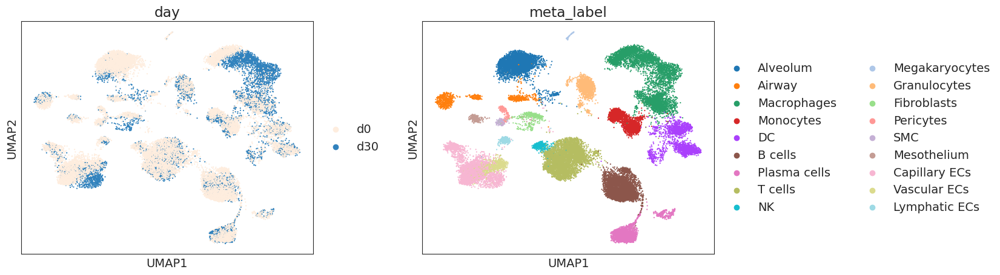

AT1 - d30
(79, 4132)


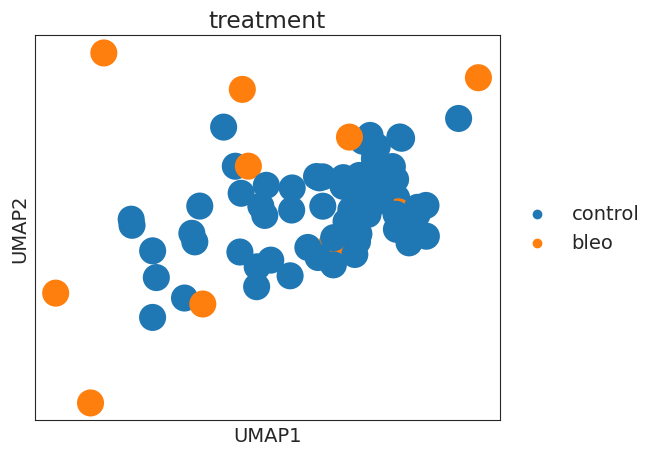

Started Diffxpy Calculation:	04-09-2024 18:27:47
training location model: True
training scale model: True
iter   0: ll=2402093.346395
caught 1084 linalg singular matrix errors
iter   1: ll=2376199.022162, converged: 0.00% (loc: 38.48%, scale update: False), in 0.43sec
iter   2: ll=2368906.208562, converged: 0.00% (loc: 38.48%, scale update: False), in 0.47sec
iter   3: ll=2367920.310596, converged: 0.00% (loc: 38.48%, scale update: False), in 0.48sec
iter   4: ll=2367849.128017, converged: 0.00% (loc: 38.48%, scale update: False), in 0.51sec
iter   5: ll=2367845.079163, converged: 0.00% (loc: 38.55%, scale update: False), in 0.51sec
iter   6: ll=302472.211343, converged: 0.00% (loc: 0.00%, scale update: True), in 2.93sec
caught 1067 linalg singular matrix errors
iter   7: ll=298645.899853, converged: 0.00% (loc: 27.42%, scale update: False), in 0.53sec
iter   8: ll=298019.431170, converged: 0.00% (loc: 28.53%, scale update: False), in 0.52sec
iter   9: ll=297956.240531, converged: 0.00

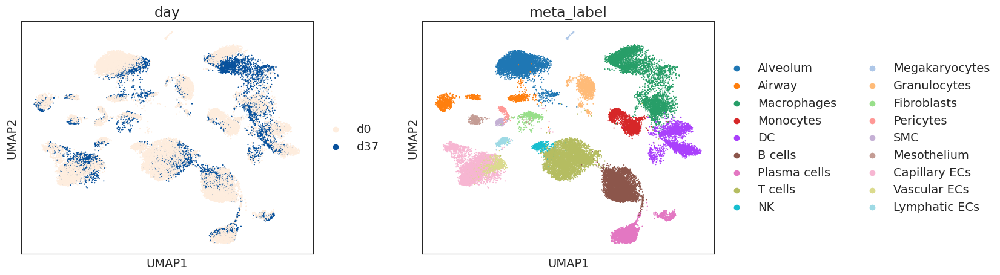

AT1 - d37
(105, 4932)


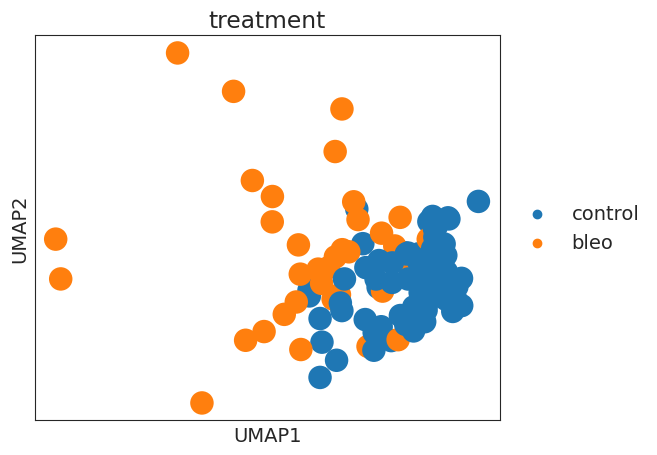

Started Diffxpy Calculation:	04-09-2024 18:28:42
training location model: True
training scale model: True
iter   0: ll=3568106.422622
caught 266 linalg singular matrix errors
iter   1: ll=3525410.818325, converged: 0.00% (loc: 25.55%, scale update: False), in 0.81sec
iter   2: ll=3512281.796528, converged: 0.00% (loc: 25.55%, scale update: False), in 0.59sec
iter   3: ll=3510005.283593, converged: 0.00% (loc: 25.55%, scale update: False), in 0.61sec
iter   4: ll=3509738.406071, converged: 0.00% (loc: 25.55%, scale update: False), in 0.59sec
iter   5: ll=3509710.908388, converged: 0.00% (loc: 25.59%, scale update: False), in 0.59sec
iter   6: ll=411398.001703, converged: 0.00% (loc: 0.00%, scale update: True), in 3.45sec
caught 265 linalg singular matrix errors
iter   7: ll=404481.830789, converged: 0.00% (loc: 7.24%, scale update: False), in 0.60sec
iter   8: ll=403042.485775, converged: 0.00% (loc: 7.77%, scale update: False), in 0.62sec
iter   9: ll=402834.269819, converged: 0.00% (l

In [38]:
subset = ["control", "bleo"]
condition = "treatment"
ct_label = "cell_type"
min_cells = 10
age = "old"
cell_types = ["AT1"]
for time in ["d3", "d10", "d20", "d30", "d37"]:
    time_subset = adata[(adata.obs.age == age) & (adata.obs.day.isin([time, "d0"]))].copy()
    for ct in cell_types:
        sc.pl.umap(time_subset, color = ["day", "meta_label"], size = 10, wspace = 0.25)
        print("%s - %s" %(ct, time))
        dge(time_subset, ct = ct, ct_label = ct_label, condition = condition, ref = "control", pct_thresh = 0.05,
              subset = subset, min_cells = min_cells, do_return = False, suffix = "_old")